# Afriat

In [1]:
scan=0.4

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: hu3vrdbg
Name: grievous-xwing-152
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/hu3vrdbg
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155931-hu3vrdbg/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2534,3273,9436
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2534,2594,1691,3435,1627,3362
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4425,10818
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 671,836,2303
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 671,608,417,855,422,837
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1159,2651
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:21<3:32:22, 21.27s/it]

Epoch 1/600:   0%|          | 1/600 [00:21<3:32:22, 21.27s/it, v_num=bg_1, total_loss_train=3.68e+3, kl_local_train=53.4]

Epoch 2/600:   0%|          | 1/600 [00:21<3:32:22, 21.27s/it, v_num=bg_1, total_loss_train=3.68e+3, kl_local_train=53.4]

Epoch 2/600:   0%|          | 2/600 [00:39<3:12:43, 19.34s/it, v_num=bg_1, total_loss_train=3.68e+3, kl_local_train=53.4]

Epoch 2/600:   0%|          | 2/600 [00:39<3:12:43, 19.34s/it, v_num=bg_1, total_loss_train=3.23e+3, kl_local_train=81.3]

Epoch 3/600:   0%|          | 2/600 [00:39<3:12:43, 19.34s/it, v_num=bg_1, total_loss_train=3.23e+3, kl_local_train=81.3]

Epoch 3/600:   0%|          | 3/600 [00:57<3:05:23, 18.63s/it, v_num=bg_1, total_loss_train=3.23e+3, kl_local_train=81.3]

Epoch 3/600:   0%|          | 3/600 [00:57<3:05:23, 18.63s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=82.2]

Epoch 4/600:   0%|          | 3/600 [00:57<3:05:23, 18.63s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=82.2]

Epoch 4/600:   1%|          | 4/600 [01:15<3:02:25, 18.36s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=82.2]

Epoch 4/600:   1%|          | 4/600 [01:15<3:02:25, 18.36s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 4/600 [01:15<3:02:25, 18.36s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 5/600 [01:33<3:02:03, 18.36s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 5/600 [01:33<3:02:03, 18.36s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=71.1]

Epoch 6/600:   1%|          | 5/600 [01:34<3:02:03, 18.36s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=71.1]

Epoch 6/600:   1%|          | 6/600 [01:51<3:02:04, 18.39s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=71.1]

Epoch 6/600:   1%|          | 6/600 [01:51<3:02:04, 18.39s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:51<3:02:04, 18.39s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [02:09<2:58:10, 18.03s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=60.5, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [02:09<2:58:10, 18.03s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [02:09<2:58:10, 18.03s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [02:26<2:56:25, 17.88s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [02:26<2:56:25, 17.88s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [02:26<2:56:25, 17.88s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:44<2:54:47, 17.74s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:44<2:54:47, 17.74s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=32.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349] 

Epoch 10/600:   2%|▏         | 9/600 [02:44<2:54:47, 17.74s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=32.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [03:02<2:55:11, 17.82s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=32.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [03:02<2:55:11, 17.82s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [03:03<2:55:11, 17.82s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [03:21<2:58:23, 18.17s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00791, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [03:21<2:58:23, 18.17s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=66.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483] 

Epoch 12/600:   2%|▏         | 11/600 [03:21<2:58:23, 18.17s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=66.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 12/600:   2%|▏         | 12/600 [03:38<2:55:22, 17.90s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=66.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 12/600:   2%|▏         | 12/600 [03:38<2:55:22, 17.90s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 13/600:   2%|▏         | 12/600 [03:38<2:55:22, 17.90s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 13/600:   2%|▏         | 13/600 [03:55<2:53:21, 17.72s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 13/600:   2%|▏         | 13/600 [03:55<2:53:21, 17.72s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 14/600:   2%|▏         | 13/600 [03:55<2:53:21, 17.72s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 14/600:   2%|▏         | 14/600 [04:12<2:51:45, 17.59s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=94.8, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 14/600:   2%|▏         | 14/600 [04:12<2:51:45, 17.59s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483] 

Epoch 15/600:   2%|▏         | 14/600 [04:12<2:51:45, 17.59s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 15/600:   2%|▎         | 15/600 [04:30<2:51:30, 17.59s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 15/600:   2%|▎         | 15/600 [04:30<2:51:30, 17.59s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=131, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 16/600:   2%|▎         | 15/600 [04:32<2:51:30, 17.59s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=131, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 16/600:   3%|▎         | 16/600 [04:49<2:55:05, 17.99s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=131, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0212, metric_mi|mouse_train=0.0483]

Epoch 16/600:   3%|▎         | 16/600 [04:49<2:55:05, 17.99s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=137, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 17/600:   3%|▎         | 16/600 [04:49<2:55:05, 17.99s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=137, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 17/600:   3%|▎         | 17/600 [05:06<2:52:10, 17.72s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=137, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 17/600:   3%|▎         | 17/600 [05:06<2:52:10, 17.72s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=137, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 18/600:   3%|▎         | 17/600 [05:06<2:52:10, 17.72s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=137, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 18/600:   3%|▎         | 18/600 [05:23<2:48:47, 17.40s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=137, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 18/600:   3%|▎         | 18/600 [05:23<2:48:47, 17.40s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 19/600:   3%|▎         | 18/600 [05:23<2:48:47, 17.40s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 19/600:   3%|▎         | 19/600 [05:39<2:46:30, 17.20s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=147, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 19/600:   3%|▎         | 19/600 [05:39<2:46:30, 17.20s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=168, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 20/600:   3%|▎         | 19/600 [05:39<2:46:30, 17.20s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=168, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 20/600:   3%|▎         | 20/600 [05:56<2:45:13, 17.09s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=168, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 20/600:   3%|▎         | 20/600 [05:56<2:45:13, 17.09s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=174, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 21/600:   3%|▎         | 20/600 [05:58<2:45:13, 17.09s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=174, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 21/600:   4%|▎         | 21/600 [06:14<2:46:23, 17.24s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=174, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0706]

Epoch 21/600:   4%|▎         | 21/600 [06:14<2:46:23, 17.24s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=161, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]   

Epoch 22/600:   4%|▎         | 21/600 [06:14<2:46:23, 17.24s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=161, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 22/600:   4%|▎         | 22/600 [06:30<2:42:26, 16.86s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=161, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 22/600:   4%|▎         | 22/600 [06:30<2:42:26, 16.86s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=140, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 23/600:   4%|▎         | 22/600 [06:30<2:42:26, 16.86s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=140, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 23/600:   4%|▍         | 23/600 [06:46<2:39:47, 16.62s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=140, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 23/600:   4%|▍         | 23/600 [06:46<2:39:47, 16.62s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=137, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 24/600:   4%|▍         | 23/600 [06:46<2:39:47, 16.62s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=137, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 24/600:   4%|▍         | 24/600 [07:02<2:37:46, 16.44s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=137, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 24/600:   4%|▍         | 24/600 [07:02<2:37:46, 16.44s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=136, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 25/600:   4%|▍         | 24/600 [07:02<2:37:46, 16.44s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=136, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 25/600:   4%|▍         | 25/600 [07:18<2:36:50, 16.37s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=136, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 25/600:   4%|▍         | 25/600 [07:18<2:36:50, 16.37s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 26/600:   4%|▍         | 25/600 [07:19<2:36:50, 16.37s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 26/600:   4%|▍         | 26/600 [07:36<2:41:51, 16.92s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.0982, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.111]

Epoch 26/600:   4%|▍         | 26/600 [07:36<2:41:51, 16.92s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=128, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132] 

Epoch 27/600:   4%|▍         | 26/600 [07:36<2:41:51, 16.92s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=128, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 27/600:   4%|▍         | 27/600 [07:54<2:43:20, 17.10s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=128, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 27/600:   4%|▍         | 27/600 [07:54<2:43:20, 17.10s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=133, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 28/600:   4%|▍         | 27/600 [07:54<2:43:20, 17.10s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=133, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 28/600:   5%|▍         | 28/600 [08:11<2:44:16, 17.23s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=133, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 28/600:   5%|▍         | 28/600 [08:11<2:44:16, 17.23s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=138, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 29/600:   5%|▍         | 28/600 [08:11<2:44:16, 17.23s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=138, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 29/600:   5%|▍         | 29/600 [08:29<2:44:51, 17.32s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=138, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 29/600:   5%|▍         | 29/600 [08:29<2:44:51, 17.32s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=142, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 30/600:   5%|▍         | 29/600 [08:29<2:44:51, 17.32s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=142, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 30/600:   5%|▌         | 30/600 [08:47<2:45:37, 17.43s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=142, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 30/600:   5%|▌         | 30/600 [08:47<2:45:37, 17.43s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 31/600:   5%|▌         | 30/600 [08:48<2:45:37, 17.43s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 31/600:   5%|▌         | 31/600 [09:06<2:49:38, 17.89s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.132]

Epoch 31/600:   5%|▌         | 31/600 [09:06<2:49:38, 17.89s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|▌         | 31/600 [09:06<2:49:38, 17.89s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|▌         | 32/600 [09:23<2:49:02, 17.86s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 32/600:   5%|▌         | 32/600 [09:23<2:49:02, 17.86s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 33/600:   5%|▌         | 32/600 [09:23<2:49:02, 17.86s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 33/600:   6%|▌         | 33/600 [09:41<2:48:08, 17.79s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 33/600:   6%|▌         | 33/600 [09:41<2:48:08, 17.79s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=143, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|▌         | 33/600 [09:41<2:48:08, 17.79s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=143, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|▌         | 34/600 [09:58<2:46:47, 17.68s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=143, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 34/600:   6%|▌         | 34/600 [09:58<2:46:47, 17.68s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|▌         | 34/600 [09:58<2:46:47, 17.68s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|▌         | 35/600 [10:16<2:46:58, 17.73s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=141, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 35/600:   6%|▌         | 35/600 [10:16<2:46:58, 17.73s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=136, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|▌         | 35/600 [10:18<2:46:58, 17.73s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=136, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|▌         | 36/600 [10:35<2:50:33, 18.14s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=136, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.141]

Epoch 36/600:   6%|▌         | 36/600 [10:35<2:50:33, 18.14s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=136, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]   

Epoch 37/600:   6%|▌         | 36/600 [10:35<2:50:33, 18.14s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=136, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 37/600 [10:53<2:47:45, 17.88s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=136, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 37/600:   6%|▌         | 37/600 [10:53<2:47:45, 17.88s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▌         | 37/600 [10:53<2:47:45, 17.88s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▋         | 38/600 [11:11<2:49:13, 18.07s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 38/600:   6%|▋         | 38/600 [11:11<2:49:13, 18.07s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 38/600 [11:11<2:49:13, 18.07s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 39/600 [11:28<2:45:26, 17.69s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 39/600:   6%|▋         | 39/600 [11:28<2:45:26, 17.69s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 40/600:   6%|▋         | 39/600 [11:28<2:45:26, 17.69s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 40/600:   7%|▋         | 40/600 [11:45<2:44:05, 17.58s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 40/600:   7%|▋         | 40/600 [11:45<2:44:05, 17.58s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=135, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 40/600 [11:47<2:44:05, 17.58s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=135, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 41/600 [12:04<2:46:37, 17.88s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=135, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.144]

Epoch 41/600:   7%|▋         | 41/600 [12:04<2:46:37, 17.88s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=133, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 42/600:   7%|▋         | 41/600 [12:04<2:46:37, 17.88s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=133, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 42/600:   7%|▋         | 42/600 [12:22<2:45:50, 17.83s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=133, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 42/600:   7%|▋         | 42/600 [12:22<2:45:50, 17.83s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=131, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 43/600:   7%|▋         | 42/600 [12:22<2:45:50, 17.83s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=131, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 43/600:   7%|▋         | 43/600 [12:39<2:45:48, 17.86s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=131, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 43/600:   7%|▋         | 43/600 [12:39<2:45:48, 17.86s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=132, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 44/600:   7%|▋         | 43/600 [12:39<2:45:48, 17.86s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=132, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 44/600:   7%|▋         | 44/600 [12:57<2:44:36, 17.76s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=132, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 44/600:   7%|▋         | 44/600 [12:57<2:44:36, 17.76s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=130, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 45/600:   7%|▋         | 44/600 [12:57<2:44:36, 17.76s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=130, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 45/600:   8%|▊         | 45/600 [13:14<2:42:42, 17.59s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=130, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 45/600:   8%|▊         | 45/600 [13:14<2:42:42, 17.59s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=132, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 46/600:   8%|▊         | 45/600 [13:16<2:42:42, 17.59s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=132, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 46/600:   8%|▊         | 46/600 [13:33<2:45:47, 17.96s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=132, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 46/600:   8%|▊         | 46/600 [13:33<2:45:47, 17.96s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 47/600:   8%|▊         | 46/600 [13:33<2:45:47, 17.96s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 47/600:   8%|▊         | 47/600 [13:50<2:43:15, 17.71s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 47/600:   8%|▊         | 47/600 [13:50<2:43:15, 17.71s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 48/600:   8%|▊         | 47/600 [13:50<2:43:15, 17.71s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 48/600:   8%|▊         | 48/600 [14:07<2:41:48, 17.59s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 48/600:   8%|▊         | 48/600 [14:07<2:41:48, 17.59s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=130, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 49/600:   8%|▊         | 48/600 [14:07<2:41:48, 17.59s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=130, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 49/600:   8%|▊         | 49/600 [14:25<2:40:26, 17.47s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=130, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 49/600:   8%|▊         | 49/600 [14:25<2:40:26, 17.47s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 50/600:   8%|▊         | 49/600 [14:25<2:40:26, 17.47s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 50/600:   8%|▊         | 50/600 [14:42<2:39:43, 17.42s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 50/600:   8%|▊         | 50/600 [14:42<2:39:43, 17.42s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 51/600:   8%|▊         | 50/600 [14:44<2:39:43, 17.42s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 51/600:   8%|▊         | 51/600 [15:01<2:43:35, 17.88s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=131, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.141]

Epoch 51/600:   8%|▊         | 51/600 [15:01<2:43:35, 17.88s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=130, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143] 

Epoch 52/600:   8%|▊         | 51/600 [15:01<2:43:35, 17.88s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=130, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 52/600:   9%|▊         | 52/600 [15:18<2:41:33, 17.69s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=130, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 52/600:   9%|▊         | 52/600 [15:18<2:41:33, 17.69s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=129, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 53/600:   9%|▊         | 52/600 [15:18<2:41:33, 17.69s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=129, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 53/600:   9%|▉         | 53/600 [15:35<2:40:02, 17.56s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=129, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 53/600:   9%|▉         | 53/600 [15:35<2:40:02, 17.56s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 54/600:   9%|▉         | 53/600 [15:35<2:40:02, 17.56s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 54/600:   9%|▉         | 54/600 [15:52<2:38:20, 17.40s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 54/600:   9%|▉         | 54/600 [15:52<2:38:20, 17.40s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 55/600:   9%|▉         | 54/600 [15:52<2:38:20, 17.40s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 55/600:   9%|▉         | 55/600 [16:10<2:38:33, 17.46s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 55/600:   9%|▉         | 55/600 [16:10<2:38:33, 17.46s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 56/600:   9%|▉         | 55/600 [16:12<2:38:33, 17.46s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 56/600:   9%|▉         | 56/600 [16:29<2:42:13, 17.89s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.143]

Epoch 56/600:   9%|▉         | 56/600 [16:29<2:42:13, 17.89s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 57/600:   9%|▉         | 56/600 [16:29<2:42:13, 17.89s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 57/600:  10%|▉         | 57/600 [16:46<2:40:12, 17.70s/it, v_num=bg_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 57/600:  10%|▉         | 57/600 [16:46<2:40:12, 17.70s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=124, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 58/600:  10%|▉         | 57/600 [16:46<2:40:12, 17.70s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=124, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 58/600:  10%|▉         | 58/600 [17:03<2:38:27, 17.54s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=124, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 58/600:  10%|▉         | 58/600 [17:03<2:38:27, 17.54s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=122, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 59/600:  10%|▉         | 58/600 [17:03<2:38:27, 17.54s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=122, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 59/600:  10%|▉         | 59/600 [17:21<2:37:11, 17.43s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=122, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 59/600:  10%|▉         | 59/600 [17:21<2:37:11, 17.43s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=121, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 60/600:  10%|▉         | 59/600 [17:21<2:37:11, 17.43s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=121, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 60/600:  10%|█         | 60/600 [17:38<2:36:47, 17.42s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=121, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 60/600:  10%|█         | 60/600 [17:38<2:36:47, 17.42s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=121, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 61/600:  10%|█         | 60/600 [17:40<2:36:47, 17.42s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=121, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 61/600:  10%|█         | 61/600 [17:58<2:44:26, 18.31s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=121, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.142]

Epoch 61/600:  10%|█         | 61/600 [17:58<2:44:26, 18.31s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 62/600:  10%|█         | 61/600 [17:58<2:44:26, 18.31s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 62/600:  10%|█         | 62/600 [18:18<2:48:28, 18.79s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 62/600:  10%|█         | 62/600 [18:18<2:48:28, 18.79s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 63/600:  10%|█         | 62/600 [18:18<2:48:28, 18.79s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 63/600:  10%|█         | 63/600 [18:37<2:47:38, 18.73s/it, v_num=bg_1, total_loss_train=3.21e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 63/600:  10%|█         | 63/600 [18:37<2:47:38, 18.73s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144] 

Epoch 64/600:  10%|█         | 63/600 [18:37<2:47:38, 18.73s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 64/600:  11%|█         | 64/600 [18:55<2:45:54, 18.57s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=120, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 64/600:  11%|█         | 64/600 [18:55<2:45:54, 18.57s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 65/600:  11%|█         | 64/600 [18:55<2:45:54, 18.57s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 65/600:  11%|█         | 65/600 [19:14<2:45:26, 18.55s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=119, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 65/600:  11%|█         | 65/600 [19:14<2:45:26, 18.55s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 66/600:  11%|█         | 65/600 [19:15<2:45:26, 18.55s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 66/600:  11%|█         | 66/600 [19:33<2:47:35, 18.83s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=118, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.144]

Epoch 66/600:  11%|█         | 66/600 [19:33<2:47:35, 18.83s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 67/600:  11%|█         | 66/600 [19:33<2:47:35, 18.83s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 67/600:  11%|█         | 67/600 [19:51<2:45:12, 18.60s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=116, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 67/600:  11%|█         | 67/600 [19:51<2:45:12, 18.60s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 68/600:  11%|█         | 67/600 [19:51<2:45:12, 18.60s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 68/600:  11%|█▏        | 68/600 [20:10<2:45:57, 18.72s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 68/600:  11%|█▏        | 68/600 [20:10<2:45:57, 18.72s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 69/600:  11%|█▏        | 68/600 [20:10<2:45:57, 18.72s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 69/600:  12%|█▏        | 69/600 [20:28<2:44:21, 18.57s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 69/600:  12%|█▏        | 69/600 [20:28<2:44:21, 18.57s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 70/600:  12%|█▏        | 69/600 [20:28<2:44:21, 18.57s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 70/600:  12%|█▏        | 70/600 [20:46<2:42:11, 18.36s/it, v_num=bg_1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 70/600:  12%|█▏        | 70/600 [20:46<2:42:11, 18.36s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 71/600:  12%|█▏        | 70/600 [20:48<2:42:11, 18.36s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 71/600:  12%|█▏        | 71/600 [21:05<2:44:12, 18.62s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=113, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.167, metric_mi|mouse_train=0.144]

Epoch 71/600:  12%|█▏        | 71/600 [21:05<2:44:12, 18.62s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|█▏        | 71/600 [21:05<2:44:12, 18.62s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|█▏        | 72/600 [21:23<2:40:51, 18.28s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 72/600:  12%|█▏        | 72/600 [21:23<2:40:51, 18.28s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|█▏        | 72/600 [21:23<2:40:51, 18.28s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|█▏        | 73/600 [21:40<2:38:05, 18.00s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 73/600:  12%|█▏        | 73/600 [21:40<2:38:05, 18.00s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|█▏        | 73/600 [21:40<2:38:05, 18.00s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|█▏        | 74/600 [21:58<2:37:42, 17.99s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 74/600:  12%|█▏        | 74/600 [21:58<2:37:42, 17.99s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|█▏        | 74/600 [21:58<2:37:42, 17.99s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|█▎        | 75/600 [22:18<2:41:39, 18.48s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 75/600:  12%|█▎        | 75/600 [22:18<2:41:39, 18.48s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 76/600:  12%|█▎        | 75/600 [22:19<2:41:39, 18.48s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 76/600:  13%|█▎        | 76/600 [22:37<2:43:22, 18.71s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=111, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.142]

Epoch 76/600:  13%|█▎        | 76/600 [22:37<2:43:22, 18.71s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 77/600:  13%|█▎        | 76/600 [22:37<2:43:22, 18.71s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 77/600:  13%|█▎        | 77/600 [22:54<2:39:48, 18.33s/it, v_num=bg_1, total_loss_train=3.19e+3, kl_local_train=110, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 77/600:  13%|█▎        | 77/600 [22:54<2:39:48, 18.33s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 78/600:  13%|█▎        | 77/600 [22:54<2:39:48, 18.33s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 78/600:  13%|█▎        | 78/600 [23:12<2:37:22, 18.09s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 78/600:  13%|█▎        | 78/600 [23:12<2:37:22, 18.09s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 79/600:  13%|█▎        | 78/600 [23:12<2:37:22, 18.09s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 79/600:  13%|█▎        | 79/600 [23:30<2:35:47, 17.94s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=109, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 79/600:  13%|█▎        | 79/600 [23:30<2:35:47, 17.94s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 80/600:  13%|█▎        | 79/600 [23:30<2:35:47, 17.94s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 80/600:  13%|█▎        | 80/600 [23:47<2:35:03, 17.89s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 80/600:  13%|█▎        | 80/600 [23:47<2:35:03, 17.89s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 81/600:  13%|█▎        | 80/600 [23:49<2:35:03, 17.89s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 81/600:  14%|█▎        | 81/600 [24:06<2:37:34, 18.22s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.138]

Epoch 81/600:  14%|█▎        | 81/600 [24:06<2:37:34, 18.22s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 82/600:  14%|█▎        | 81/600 [24:06<2:37:34, 18.22s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 82/600:  14%|█▎        | 82/600 [24:24<2:35:10, 17.97s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 82/600:  14%|█▎        | 82/600 [24:24<2:35:10, 17.97s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 83/600:  14%|█▎        | 82/600 [24:24<2:35:10, 17.97s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 83/600:  14%|█▍        | 83/600 [24:41<2:33:33, 17.82s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 83/600:  14%|█▍        | 83/600 [24:41<2:33:33, 17.82s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 84/600:  14%|█▍        | 83/600 [24:41<2:33:33, 17.82s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 84/600:  14%|█▍        | 84/600 [24:58<2:31:47, 17.65s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 84/600:  14%|█▍        | 84/600 [24:58<2:31:47, 17.65s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 85/600:  14%|█▍        | 84/600 [24:58<2:31:47, 17.65s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 85/600:  14%|█▍        | 85/600 [25:16<2:30:59, 17.59s/it, v_num=bg_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 85/600:  14%|█▍        | 85/600 [25:16<2:30:59, 17.59s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 86/600:  14%|█▍        | 85/600 [25:17<2:30:59, 17.59s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 86/600:  14%|█▍        | 86/600 [25:35<2:34:24, 18.03s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.136]

Epoch 86/600:  14%|█▍        | 86/600 [25:35<2:34:24, 18.03s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 87/600:  14%|█▍        | 86/600 [25:35<2:34:24, 18.03s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 87/600:  14%|█▍        | 87/600 [25:52<2:32:38, 17.85s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 87/600:  14%|█▍        | 87/600 [25:52<2:32:38, 17.85s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 88/600:  14%|█▍        | 87/600 [25:52<2:32:38, 17.85s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 88/600:  15%|█▍        | 88/600 [26:10<2:31:07, 17.71s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 88/600:  15%|█▍        | 88/600 [26:10<2:31:07, 17.71s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 89/600:  15%|█▍        | 88/600 [26:10<2:31:07, 17.71s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 89/600:  15%|█▍        | 89/600 [26:27<2:29:57, 17.61s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 89/600:  15%|█▍        | 89/600 [26:27<2:29:57, 17.61s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 90/600:  15%|█▍        | 89/600 [26:27<2:29:57, 17.61s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 90/600:  15%|█▌        | 90/600 [26:45<2:31:03, 17.77s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 90/600:  15%|█▌        | 90/600 [26:45<2:31:03, 17.77s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 91/600:  15%|█▌        | 90/600 [26:47<2:31:03, 17.77s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 91/600:  15%|█▌        | 91/600 [27:04<2:34:02, 18.16s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.135]

Epoch 91/600:  15%|█▌        | 91/600 [27:04<2:34:02, 18.16s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 92/600:  15%|█▌        | 91/600 [27:04<2:34:02, 18.16s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 92/600:  15%|█▌        | 92/600 [27:22<2:32:13, 17.98s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 92/600:  15%|█▌        | 92/600 [27:22<2:32:13, 17.98s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 93/600:  15%|█▌        | 92/600 [27:22<2:32:13, 17.98s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 93/600:  16%|█▌        | 93/600 [27:39<2:30:17, 17.79s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 93/600:  16%|█▌        | 93/600 [27:39<2:30:17, 17.79s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 94/600:  16%|█▌        | 93/600 [27:39<2:30:17, 17.79s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 94/600:  16%|█▌        | 94/600 [27:57<2:29:15, 17.70s/it, v_num=bg_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 94/600:  16%|█▌        | 94/600 [27:57<2:29:15, 17.70s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 95/600:  16%|█▌        | 94/600 [27:57<2:29:15, 17.70s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 95/600:  16%|█▌        | 95/600 [28:14<2:27:47, 17.56s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=102, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 95/600:  16%|█▌        | 95/600 [28:14<2:27:47, 17.56s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=101, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 96/600:  16%|█▌        | 95/600 [28:16<2:27:47, 17.56s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=101, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 96/600:  16%|█▌        | 96/600 [28:33<2:30:06, 17.87s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=101, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.136]

Epoch 96/600:  16%|█▌        | 96/600 [28:33<2:30:06, 17.87s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=100, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 97/600:  16%|█▌        | 96/600 [28:33<2:30:06, 17.87s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=100, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 97/600:  16%|█▌        | 97/600 [28:50<2:27:51, 17.64s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=100, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 97/600:  16%|█▌        | 97/600 [28:50<2:27:51, 17.64s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 98/600:  16%|█▌        | 97/600 [28:50<2:27:51, 17.64s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 98/600:  16%|█▋        | 98/600 [29:07<2:25:57, 17.44s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99.7, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 98/600:  16%|█▋        | 98/600 [29:07<2:25:57, 17.44s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=101, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131] 

Epoch 99/600:  16%|█▋        | 98/600 [29:07<2:25:57, 17.44s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=101, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 99/600:  16%|█▋        | 99/600 [29:23<2:23:49, 17.22s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=101, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 99/600:  16%|█▋        | 99/600 [29:23<2:23:49, 17.22s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=100, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 100/600:  16%|█▋        | 99/600 [29:23<2:23:49, 17.22s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=100, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 100/600:  17%|█▋        | 100/600 [29:40<2:21:54, 17.03s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=100, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 100/600:  17%|█▋        | 100/600 [29:40<2:21:54, 17.03s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=98.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 101/600:  17%|█▋        | 100/600 [29:41<2:21:54, 17.03s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=98.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 101/600:  17%|█▋        | 101/600 [29:58<2:24:09, 17.33s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=98.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.131]

Epoch 101/600:  17%|█▋        | 101/600 [29:58<2:24:09, 17.33s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 102/600:  17%|█▋        | 101/600 [29:58<2:24:09, 17.33s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 102/600:  17%|█▋        | 102/600 [30:14<2:21:36, 17.06s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 102/600:  17%|█▋        | 102/600 [30:14<2:21:36, 17.06s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]  

Epoch 103/600:  17%|█▋        | 102/600 [30:14<2:21:36, 17.06s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 103/600:  17%|█▋        | 103/600 [30:31<2:20:08, 16.92s/it, v_num=bg_1, total_loss_train=3.16e+3, kl_local_train=99, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 103/600:  17%|█▋        | 103/600 [30:31<2:20:08, 16.92s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=98.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 104/600:  17%|█▋        | 103/600 [30:31<2:20:08, 16.92s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=98.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 104/600:  17%|█▋        | 104/600 [30:50<2:24:36, 17.49s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=98.5, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 104/600:  17%|█▋        | 104/600 [30:50<2:24:36, 17.49s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 105/600:  17%|█▋        | 104/600 [30:50<2:24:36, 17.49s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 105/600:  18%|█▊        | 105/600 [31:08<2:26:01, 17.70s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 105/600:  18%|█▊        | 105/600 [31:08<2:26:01, 17.70s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 106/600:  18%|█▊        | 105/600 [31:10<2:26:01, 17.70s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 106/600:  18%|█▊        | 106/600 [31:28<2:30:59, 18.34s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.3, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.125]

Epoch 106/600:  18%|█▊        | 106/600 [31:28<2:30:59, 18.34s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]  

Epoch 107/600:  18%|█▊        | 106/600 [31:28<2:30:59, 18.34s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 107/600:  18%|█▊        | 107/600 [31:46<2:30:46, 18.35s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 107/600:  18%|█▊        | 107/600 [31:46<2:30:46, 18.35s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 108/600:  18%|█▊        | 107/600 [31:46<2:30:46, 18.35s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 108/600:  18%|█▊        | 108/600 [32:05<2:30:32, 18.36s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=97.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 108/600:  18%|█▊        | 108/600 [32:05<2:30:32, 18.36s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 109/600:  18%|█▊        | 108/600 [32:05<2:30:32, 18.36s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 109/600:  18%|█▊        | 109/600 [32:23<2:29:53, 18.32s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 109/600:  18%|█▊        | 109/600 [32:23<2:29:53, 18.32s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 110/600:  18%|█▊        | 109/600 [32:23<2:29:53, 18.32s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 110/600:  18%|█▊        | 110/600 [32:41<2:29:37, 18.32s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.6, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 110/600:  18%|█▊        | 110/600 [32:41<2:29:37, 18.32s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 111/600:  18%|█▊        | 110/600 [32:43<2:29:37, 18.32s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 111/600:  18%|█▊        | 111/600 [33:01<2:32:36, 18.72s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.5, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.129]

Epoch 111/600:  18%|█▊        | 111/600 [33:01<2:32:36, 18.72s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 112/600:  18%|█▊        | 111/600 [33:01<2:32:36, 18.72s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 112/600:  19%|█▊        | 112/600 [33:18<2:29:39, 18.40s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 112/600:  19%|█▊        | 112/600 [33:18<2:29:39, 18.40s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 113/600:  19%|█▊        | 112/600 [33:19<2:29:39, 18.40s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 113/600:  19%|█▉        | 113/600 [33:36<2:27:41, 18.20s/it, v_num=bg_1, total_loss_train=3.15e+3, kl_local_train=95.2, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 113/600:  19%|█▉        | 113/600 [33:36<2:27:41, 18.20s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=95, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]  

Epoch 114/600:  19%|█▉        | 113/600 [33:36<2:27:41, 18.20s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=95, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 114/600:  19%|█▉        | 114/600 [33:54<2:25:59, 18.02s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=95, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 114/600:  19%|█▉        | 114/600 [33:54<2:25:59, 18.02s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=94.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 115/600:  19%|█▉        | 114/600 [33:54<2:25:59, 18.02s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=94.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 115/600:  19%|█▉        | 115/600 [34:13<2:27:59, 18.31s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=94.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 115/600:  19%|█▉        | 115/600 [34:13<2:27:59, 18.31s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=94.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 116/600:  19%|█▉        | 115/600 [34:14<2:27:59, 18.31s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=94.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 116/600:  19%|█▉        | 116/600 [34:31<2:27:05, 18.23s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=94.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.131]

Epoch 116/600:  19%|█▉        | 116/600 [34:31<2:27:05, 18.23s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]  

Epoch 117/600:  19%|█▉        | 116/600 [34:31<2:27:05, 18.23s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 117/600:  20%|█▉        | 117/600 [34:48<2:24:13, 17.92s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.8, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 117/600:  20%|█▉        | 117/600 [34:48<2:24:13, 17.92s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 118/600:  20%|█▉        | 117/600 [34:48<2:24:13, 17.92s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 118/600:  20%|█▉        | 118/600 [35:06<2:23:51, 17.91s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.7, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 118/600:  20%|█▉        | 118/600 [35:06<2:23:51, 17.91s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 119/600:  20%|█▉        | 118/600 [35:06<2:23:51, 17.91s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 119/600:  20%|█▉        | 119/600 [35:24<2:22:53, 17.83s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=93.3, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 119/600:  20%|█▉        | 119/600 [35:24<2:22:53, 17.83s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 120/600:  20%|█▉        | 119/600 [35:24<2:22:53, 17.83s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 120/600:  20%|██        | 120/600 [35:42<2:24:25, 18.05s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 120/600:  20%|██        | 120/600 [35:42<2:24:25, 18.05s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 121/600:  20%|██        | 120/600 [35:44<2:24:25, 18.05s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 121/600:  20%|██        | 121/600 [36:01<2:26:39, 18.37s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.132]

Epoch 121/600:  20%|██        | 121/600 [36:01<2:26:39, 18.37s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 122/600:  20%|██        | 121/600 [36:01<2:26:39, 18.37s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 122/600:  20%|██        | 122/600 [36:19<2:24:36, 18.15s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 122/600:  20%|██        | 122/600 [36:19<2:24:36, 18.15s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=91.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 123/600:  20%|██        | 122/600 [36:19<2:24:36, 18.15s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=91.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 123/600:  20%|██        | 123/600 [36:36<2:22:46, 17.96s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=91.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 123/600:  20%|██        | 123/600 [36:36<2:22:46, 17.96s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 124/600:  20%|██        | 123/600 [36:36<2:22:46, 17.96s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 124/600:  21%|██        | 124/600 [36:54<2:22:06, 17.91s/it, v_num=bg_1, total_loss_train=3.14e+3, kl_local_train=92.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 124/600:  21%|██        | 124/600 [36:54<2:22:06, 17.91s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=92, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]  

Epoch 125/600:  21%|██        | 124/600 [36:54<2:22:06, 17.91s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=92, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 125/600:  21%|██        | 125/600 [37:12<2:20:40, 17.77s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=92, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 125/600:  21%|██        | 125/600 [37:12<2:20:40, 17.77s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=91.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 126/600:  21%|██        | 125/600 [37:13<2:20:40, 17.77s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=91.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 126/600:  21%|██        | 126/600 [37:32<2:25:44, 18.45s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=91.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.13]

Epoch 126/600:  21%|██        | 126/600 [37:32<2:25:44, 18.45s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=91.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 127/600:  21%|██        | 126/600 [37:32<2:25:44, 18.45s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=91.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 127/600:  21%|██        | 127/600 [37:54<2:34:09, 19.55s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=91.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 127/600:  21%|██        | 127/600 [37:54<2:34:09, 19.55s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 128/600:  21%|██        | 127/600 [37:54<2:34:09, 19.55s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 128/600:  21%|██▏       | 128/600 [38:13<2:32:23, 19.37s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 128/600:  21%|██▏       | 128/600 [38:13<2:32:23, 19.37s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 129/600:  21%|██▏       | 128/600 [38:13<2:32:23, 19.37s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 129/600:  22%|██▏       | 129/600 [38:30<2:27:38, 18.81s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 129/600:  22%|██▏       | 129/600 [38:30<2:27:38, 18.81s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 130/600:  22%|██▏       | 129/600 [38:30<2:27:38, 18.81s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 130/600:  22%|██▏       | 130/600 [38:48<2:24:21, 18.43s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 130/600:  22%|██▏       | 130/600 [38:48<2:24:21, 18.43s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 131/600:  22%|██▏       | 130/600 [38:49<2:24:21, 18.43s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 131/600:  22%|██▏       | 131/600 [39:07<2:25:04, 18.56s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.128]

Epoch 131/600:  22%|██▏       | 131/600 [39:07<2:25:04, 18.56s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]  

Epoch 132/600:  22%|██▏       | 131/600 [39:07<2:25:04, 18.56s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 132/600:  22%|██▏       | 132/600 [39:24<2:21:34, 18.15s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 132/600:  22%|██▏       | 132/600 [39:24<2:21:34, 18.15s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 133/600:  22%|██▏       | 132/600 [39:24<2:21:34, 18.15s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 133/600:  22%|██▏       | 133/600 [39:41<2:19:10, 17.88s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=90.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 133/600:  22%|██▏       | 133/600 [39:41<2:19:10, 17.88s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=89.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 134/600:  22%|██▏       | 133/600 [39:41<2:19:10, 17.88s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=89.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 134/600:  22%|██▏       | 134/600 [39:58<2:17:39, 17.72s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=89.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 134/600:  22%|██▏       | 134/600 [39:58<2:17:39, 17.72s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=88.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 135/600:  22%|██▏       | 134/600 [39:58<2:17:39, 17.72s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=88.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 135/600:  22%|██▎       | 135/600 [40:16<2:15:55, 17.54s/it, v_num=bg_1, total_loss_train=3.13e+3, kl_local_train=88.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 135/600:  22%|██▎       | 135/600 [40:16<2:15:55, 17.54s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=89.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 136/600:  22%|██▎       | 135/600 [40:17<2:15:55, 17.54s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=89.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 136/600:  23%|██▎       | 136/600 [40:34<2:16:33, 17.66s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=89.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.126]

Epoch 136/600:  23%|██▎       | 136/600 [40:34<2:16:33, 17.66s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 137/600:  23%|██▎       | 136/600 [40:34<2:16:33, 17.66s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 137/600:  23%|██▎       | 137/600 [40:50<2:13:50, 17.34s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.8, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 137/600:  23%|██▎       | 137/600 [40:50<2:13:50, 17.34s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 138/600:  23%|██▎       | 137/600 [40:50<2:13:50, 17.34s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 138/600:  23%|██▎       | 138/600 [41:07<2:12:18, 17.18s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 138/600:  23%|██▎       | 138/600 [41:07<2:12:18, 17.18s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 139/600:  23%|██▎       | 138/600 [41:07<2:12:18, 17.18s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 139/600:  23%|██▎       | 139/600 [41:24<2:11:51, 17.16s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 139/600:  23%|██▎       | 139/600 [41:24<2:11:51, 17.16s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 140/600:  23%|██▎       | 139/600 [41:24<2:11:51, 17.16s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 140/600:  23%|██▎       | 140/600 [41:41<2:12:14, 17.25s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.5, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 140/600:  23%|██▎       | 140/600 [41:41<2:12:14, 17.25s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 141/600:  23%|██▎       | 140/600 [41:43<2:12:14, 17.25s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 141/600:  24%|██▎       | 141/600 [41:59<2:13:22, 17.44s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=88.2, metric_mi|status_control_train=0.194, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.124]

Epoch 141/600:  24%|██▎       | 141/600 [41:59<2:13:22, 17.44s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 142/600:  24%|██▎       | 141/600 [41:59<2:13:22, 17.44s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 142/600:  24%|██▎       | 142/600 [42:16<2:10:28, 17.09s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 142/600:  24%|██▎       | 142/600 [42:16<2:10:28, 17.09s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 143/600:  24%|██▎       | 142/600 [42:16<2:10:28, 17.09s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 143/600:  24%|██▍       | 143/600 [42:32<2:08:43, 16.90s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87.4, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 143/600:  24%|██▍       | 143/600 [42:32<2:08:43, 16.90s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]  

Epoch 144/600:  24%|██▍       | 143/600 [42:32<2:08:43, 16.90s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 144/600:  24%|██▍       | 144/600 [42:53<2:18:19, 18.20s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 144/600:  24%|██▍       | 144/600 [42:53<2:18:19, 18.20s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 145/600:  24%|██▍       | 144/600 [42:53<2:18:19, 18.20s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 145/600:  24%|██▍       | 145/600 [43:13<2:21:57, 18.72s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 145/600:  24%|██▍       | 145/600 [43:13<2:21:57, 18.72s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 146/600:  24%|██▍       | 145/600 [43:15<2:21:57, 18.72s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 146/600:  24%|██▍       | 146/600 [43:33<2:23:39, 18.99s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=87, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.125]

Epoch 146/600:  24%|██▍       | 146/600 [43:33<2:23:39, 18.99s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=86.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 147/600:  24%|██▍       | 146/600 [43:33<2:23:39, 18.99s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=86.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 147/600:  24%|██▍       | 147/600 [43:51<2:21:21, 18.72s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=86.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 147/600:  24%|██▍       | 147/600 [43:51<2:21:21, 18.72s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=86.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 148/600:  24%|██▍       | 147/600 [43:51<2:21:21, 18.72s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=86.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 148/600:  25%|██▍       | 148/600 [44:09<2:20:20, 18.63s/it, v_num=bg_1, total_loss_train=3.12e+3, kl_local_train=86.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 148/600:  25%|██▍       | 148/600 [44:09<2:20:20, 18.63s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=86.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 149/600:  25%|██▍       | 148/600 [44:09<2:20:20, 18.63s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=86.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 149/600:  25%|██▍       | 149/600 [44:28<2:19:05, 18.50s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=86.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 149/600:  25%|██▍       | 149/600 [44:28<2:19:05, 18.50s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=86.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 150/600:  25%|██▍       | 149/600 [44:28<2:19:05, 18.50s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=86.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 150/600:  25%|██▌       | 150/600 [44:46<2:18:13, 18.43s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=86.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 150/600:  25%|██▌       | 150/600 [44:46<2:18:13, 18.43s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 151/600:  25%|██▌       | 150/600 [44:47<2:18:13, 18.43s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 151/600:  25%|██▌       | 151/600 [45:06<2:21:07, 18.86s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.8, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 151/600:  25%|██▌       | 151/600 [45:06<2:21:07, 18.86s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 152/600:  25%|██▌       | 151/600 [45:06<2:21:07, 18.86s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 152/600:  25%|██▌       | 152/600 [45:24<2:18:25, 18.54s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 152/600:  25%|██▌       | 152/600 [45:24<2:18:25, 18.54s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 153/600:  25%|██▌       | 152/600 [45:24<2:18:25, 18.54s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 153/600:  26%|██▌       | 153/600 [45:41<2:16:06, 18.27s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=85.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 153/600:  26%|██▌       | 153/600 [45:41<2:16:06, 18.27s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 154/600:  26%|██▌       | 153/600 [45:41<2:16:06, 18.27s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 154/600:  26%|██▌       | 154/600 [45:58<2:13:43, 17.99s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 154/600:  26%|██▌       | 154/600 [45:59<2:13:43, 17.99s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 155/600:  26%|██▌       | 154/600 [45:59<2:13:43, 17.99s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 155/600:  26%|██▌       | 155/600 [46:16<2:13:01, 17.94s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 155/600:  26%|██▌       | 155/600 [46:16<2:13:01, 17.94s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 156/600:  26%|██▌       | 155/600 [46:18<2:13:01, 17.94s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 156/600:  26%|██▌       | 156/600 [46:35<2:15:15, 18.28s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 156/600:  26%|██▌       | 156/600 [46:35<2:15:15, 18.28s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 157/600:  26%|██▌       | 156/600 [46:35<2:15:15, 18.28s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 157/600:  26%|██▌       | 157/600 [46:53<2:13:15, 18.05s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 157/600:  26%|██▌       | 157/600 [46:53<2:13:15, 18.05s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 158/600:  26%|██▌       | 157/600 [46:53<2:13:15, 18.05s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 158/600:  26%|██▋       | 158/600 [47:10<2:11:36, 17.87s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 158/600:  26%|██▋       | 158/600 [47:10<2:11:36, 17.87s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 159/600:  26%|██▋       | 158/600 [47:10<2:11:36, 17.87s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 159/600:  26%|██▋       | 159/600 [47:28<2:11:28, 17.89s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84.4, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 159/600:  26%|██▋       | 159/600 [47:28<2:11:28, 17.89s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=83.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 160/600:  26%|██▋       | 159/600 [47:28<2:11:28, 17.89s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=83.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 160/600:  27%|██▋       | 160/600 [47:46<2:10:23, 17.78s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=83.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 160/600:  27%|██▋       | 160/600 [47:46<2:10:23, 17.78s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=83.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 161/600:  27%|██▋       | 160/600 [47:47<2:10:23, 17.78s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=83.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 161/600:  27%|██▋       | 161/600 [48:05<2:12:31, 18.11s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=83.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.127]

Epoch 161/600:  27%|██▋       | 161/600 [48:05<2:12:31, 18.11s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]  

Epoch 162/600:  27%|██▋       | 161/600 [48:05<2:12:31, 18.11s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 162/600:  27%|██▋       | 162/600 [48:22<2:11:04, 17.95s/it, v_num=bg_1, total_loss_train=3.11e+3, kl_local_train=84, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 162/600:  27%|██▋       | 162/600 [48:22<2:11:04, 17.95s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 163/600:  27%|██▋       | 162/600 [48:22<2:11:04, 17.95s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 163/600:  27%|██▋       | 163/600 [48:40<2:09:55, 17.84s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 163/600:  27%|██▋       | 163/600 [48:40<2:09:55, 17.84s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 164/600:  27%|██▋       | 163/600 [48:40<2:09:55, 17.84s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 164/600:  27%|██▋       | 164/600 [48:58<2:09:17, 17.79s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 164/600:  27%|██▋       | 164/600 [48:58<2:09:17, 17.79s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 165/600:  27%|██▋       | 164/600 [48:58<2:09:17, 17.79s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 165/600:  28%|██▊       | 165/600 [49:15<2:08:41, 17.75s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=83.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 165/600:  28%|██▊       | 165/600 [49:15<2:08:41, 17.75s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 166/600:  28%|██▊       | 165/600 [49:17<2:08:41, 17.75s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 166/600:  28%|██▊       | 166/600 [49:34<2:11:04, 18.12s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.9, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.126]

Epoch 166/600:  28%|██▊       | 166/600 [49:34<2:11:04, 18.12s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 167/600:  28%|██▊       | 166/600 [49:34<2:11:04, 18.12s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 167/600:  28%|██▊       | 167/600 [49:52<2:09:29, 17.94s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 167/600:  28%|██▊       | 167/600 [49:52<2:09:29, 17.94s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 168/600:  28%|██▊       | 167/600 [49:52<2:09:29, 17.94s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 168/600:  28%|██▊       | 168/600 [50:09<2:08:09, 17.80s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 168/600:  28%|██▊       | 168/600 [50:09<2:08:09, 17.80s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 169/600:  28%|██▊       | 168/600 [50:09<2:08:09, 17.80s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 169/600:  28%|██▊       | 169/600 [50:27<2:07:18, 17.72s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 169/600:  28%|██▊       | 169/600 [50:27<2:07:18, 17.72s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 170/600:  28%|██▊       | 169/600 [50:27<2:07:18, 17.72s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 170/600:  28%|██▊       | 170/600 [50:44<2:06:48, 17.69s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 170/600:  28%|██▊       | 170/600 [50:44<2:06:48, 17.69s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 171/600:  28%|██▊       | 170/600 [50:46<2:06:48, 17.69s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 171/600:  28%|██▊       | 171/600 [51:03<2:09:32, 18.12s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 171/600:  28%|██▊       | 171/600 [51:03<2:09:32, 18.12s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 172/600:  28%|██▊       | 171/600 [51:03<2:09:32, 18.12s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 172/600:  29%|██▊       | 172/600 [51:21<2:08:00, 17.95s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=82.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 172/600:  29%|██▊       | 172/600 [51:21<2:08:00, 17.95s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 173/600:  29%|██▊       | 172/600 [51:21<2:08:00, 17.95s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 173/600:  29%|██▉       | 173/600 [51:39<2:06:51, 17.83s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 173/600:  29%|██▉       | 173/600 [51:39<2:06:51, 17.83s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 174/600:  29%|██▉       | 173/600 [51:39<2:06:51, 17.83s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 174/600:  29%|██▉       | 174/600 [51:56<2:05:56, 17.74s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 174/600:  29%|██▉       | 174/600 [51:56<2:05:56, 17.74s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 175/600:  29%|██▉       | 174/600 [51:56<2:05:56, 17.74s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 175/600:  29%|██▉       | 175/600 [52:13<2:04:54, 17.63s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 175/600:  29%|██▉       | 175/600 [52:13<2:04:54, 17.63s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 176/600:  29%|██▉       | 175/600 [52:15<2:04:54, 17.63s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 176/600:  29%|██▉       | 176/600 [52:32<2:07:26, 18.03s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.127]

Epoch 176/600:  29%|██▉       | 176/600 [52:32<2:07:26, 18.03s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=80.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129] 

Epoch 177/600:  29%|██▉       | 176/600 [52:32<2:07:26, 18.03s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=80.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 177/600:  30%|██▉       | 177/600 [52:50<2:06:13, 17.90s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=80.9, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 177/600:  30%|██▉       | 177/600 [52:50<2:06:13, 17.90s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]  

Epoch 178/600:  30%|██▉       | 177/600 [52:50<2:06:13, 17.90s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 178/600:  30%|██▉       | 178/600 [53:08<2:05:48, 17.89s/it, v_num=bg_1, total_loss_train=3.1e+3, kl_local_train=81, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 178/600:  30%|██▉       | 178/600 [53:08<2:05:48, 17.89s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=81.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 179/600:  30%|██▉       | 178/600 [53:08<2:05:48, 17.89s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=81.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 179/600:  30%|██▉       | 179/600 [53:25<2:04:35, 17.76s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=81.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 179/600:  30%|██▉       | 179/600 [53:25<2:04:35, 17.76s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 180/600:  30%|██▉       | 179/600 [53:25<2:04:35, 17.76s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 180/600:  30%|███       | 180/600 [53:43<2:04:23, 17.77s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.8, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 180/600:  30%|███       | 180/600 [53:43<2:04:23, 17.77s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 181/600:  30%|███       | 180/600 [53:45<2:04:23, 17.77s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 181/600:  30%|███       | 181/600 [54:02<2:06:59, 18.19s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.129]

Epoch 181/600:  30%|███       | 181/600 [54:02<2:06:59, 18.19s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 182/600:  30%|███       | 181/600 [54:02<2:06:59, 18.19s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 182/600:  30%|███       | 182/600 [54:20<2:05:16, 17.98s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 182/600:  30%|███       | 182/600 [54:20<2:05:16, 17.98s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 183/600:  30%|███       | 182/600 [54:20<2:05:16, 17.98s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 183/600:  30%|███       | 183/600 [54:37<2:03:55, 17.83s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 183/600:  30%|███       | 183/600 [54:37<2:03:55, 17.83s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 184/600:  30%|███       | 183/600 [54:37<2:03:55, 17.83s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 184/600:  31%|███       | 184/600 [54:55<2:02:52, 17.72s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=80.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 184/600:  31%|███       | 184/600 [54:55<2:02:52, 17.72s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 185/600:  31%|███       | 184/600 [54:55<2:02:52, 17.72s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 185/600:  31%|███       | 185/600 [55:12<2:02:24, 17.70s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 185/600:  31%|███       | 185/600 [55:12<2:02:24, 17.70s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 186/600:  31%|███       | 185/600 [55:14<2:02:24, 17.70s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 186/600:  31%|███       | 186/600 [55:32<2:06:04, 18.27s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.126]

Epoch 186/600:  31%|███       | 186/600 [55:32<2:06:04, 18.27s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 187/600:  31%|███       | 186/600 [55:32<2:06:04, 18.27s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 187/600:  31%|███       | 187/600 [55:49<2:04:10, 18.04s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 187/600:  31%|███       | 187/600 [55:49<2:04:10, 18.04s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 188/600:  31%|███       | 187/600 [55:50<2:04:10, 18.04s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 188/600:  31%|███▏      | 188/600 [56:07<2:02:46, 17.88s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 188/600:  31%|███▏      | 188/600 [56:07<2:02:46, 17.88s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]  

Epoch 189/600:  31%|███▏      | 188/600 [56:07<2:02:46, 17.88s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 189/600:  32%|███▏      | 189/600 [56:24<2:01:16, 17.70s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 189/600:  32%|███▏      | 189/600 [56:24<2:01:16, 17.70s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 190/600:  32%|███▏      | 189/600 [56:24<2:01:16, 17.70s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 190/600:  32%|███▏      | 190/600 [56:42<2:00:11, 17.59s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 190/600:  32%|███▏      | 190/600 [56:42<2:00:11, 17.59s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 191/600:  32%|███▏      | 190/600 [56:43<2:00:11, 17.59s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 191/600:  32%|███▏      | 191/600 [57:00<2:02:23, 17.96s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.124]

Epoch 191/600:  32%|███▏      | 191/600 [57:00<2:02:23, 17.96s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123] 

Epoch 192/600:  32%|███▏      | 191/600 [57:00<2:02:23, 17.96s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 192/600:  32%|███▏      | 192/600 [57:19<2:03:32, 18.17s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=79.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 192/600:  32%|███▏      | 192/600 [57:19<2:03:32, 18.17s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 193/600:  32%|███▏      | 192/600 [57:19<2:03:32, 18.17s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 193/600:  32%|███▏      | 193/600 [57:36<2:01:22, 17.89s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 193/600:  32%|███▏      | 193/600 [57:36<2:01:22, 17.89s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 194/600:  32%|███▏      | 193/600 [57:36<2:01:22, 17.89s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 194/600:  32%|███▏      | 194/600 [57:53<1:58:35, 17.52s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 194/600:  32%|███▏      | 194/600 [57:53<1:58:35, 17.52s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 195/600:  32%|███▏      | 194/600 [57:53<1:58:35, 17.52s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 195/600:  32%|███▎      | 195/600 [58:11<1:59:17, 17.67s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 195/600:  32%|███▎      | 195/600 [58:11<1:59:17, 17.67s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 196/600:  32%|███▎      | 195/600 [58:12<1:59:17, 17.67s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 196/600:  33%|███▎      | 196/600 [58:31<2:04:10, 18.44s/it, v_num=bg_1, total_loss_train=3.09e+3, kl_local_train=78.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 196/600:  33%|███▎      | 196/600 [58:31<2:04:10, 18.44s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 197/600:  33%|███▎      | 196/600 [58:31<2:04:10, 18.44s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 197/600:  33%|███▎      | 197/600 [58:48<2:00:22, 17.92s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 197/600:  33%|███▎      | 197/600 [58:48<2:00:22, 17.92s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 198/600:  33%|███▎      | 197/600 [58:48<2:00:22, 17.92s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 198/600:  33%|███▎      | 198/600 [59:05<1:57:50, 17.59s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 198/600:  33%|███▎      | 198/600 [59:05<1:57:50, 17.59s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 199/600:  33%|███▎      | 198/600 [59:05<1:57:50, 17.59s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 199/600:  33%|███▎      | 199/600 [59:22<1:57:22, 17.56s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 199/600:  33%|███▎      | 199/600 [59:22<1:57:22, 17.56s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]  

Epoch 200/600:  33%|███▎      | 199/600 [59:22<1:57:22, 17.56s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 200/600:  33%|███▎      | 200/600 [59:40<1:57:01, 17.55s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=78, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 200/600:  33%|███▎      | 200/600 [59:40<1:57:01, 17.55s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 201/600:  33%|███▎      | 200/600 [59:41<1:57:01, 17.55s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 201/600:  34%|███▎      | 201/600 [59:59<1:59:36, 17.99s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.123]

Epoch 201/600:  34%|███▎      | 201/600 [59:59<1:59:36, 17.99s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 202/600:  34%|███▎      | 201/600 [59:59<1:59:36, 17.99s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 202/600:  34%|███▎      | 202/600 [1:00:16<1:58:19, 17.84s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.4, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 202/600:  34%|███▎      | 202/600 [1:00:16<1:58:19, 17.84s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 203/600:  34%|███▎      | 202/600 [1:00:16<1:58:19, 17.84s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 203/600:  34%|███▍      | 203/600 [1:00:34<1:56:49, 17.65s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 203/600:  34%|███▍      | 203/600 [1:00:34<1:56:49, 17.65s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 204/600:  34%|███▍      | 203/600 [1:00:34<1:56:49, 17.65s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 204/600:  34%|███▍      | 204/600 [1:00:51<1:56:17, 17.62s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.3, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 204/600:  34%|███▍      | 204/600 [1:00:51<1:56:17, 17.62s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 205/600:  34%|███▍      | 204/600 [1:00:51<1:56:17, 17.62s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 205/600:  34%|███▍      | 205/600 [1:01:09<1:56:13, 17.65s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 205/600:  34%|███▍      | 205/600 [1:01:09<1:56:13, 17.65s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]  

Epoch 206/600:  34%|███▍      | 205/600 [1:01:10<1:56:13, 17.65s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 206/600:  34%|███▍      | 206/600 [1:01:28<1:58:02, 17.98s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=77, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.124]

Epoch 206/600:  34%|███▍      | 206/600 [1:01:28<1:58:02, 17.98s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 207/600:  34%|███▍      | 206/600 [1:01:28<1:58:02, 17.98s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 207/600:  34%|███▍      | 207/600 [1:01:44<1:54:52, 17.54s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 207/600:  34%|███▍      | 207/600 [1:01:44<1:54:52, 17.54s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 208/600:  34%|███▍      | 207/600 [1:01:44<1:54:52, 17.54s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 208/600:  35%|███▍      | 208/600 [1:02:01<1:53:00, 17.30s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 208/600:  35%|███▍      | 208/600 [1:02:01<1:53:00, 17.30s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 209/600:  35%|███▍      | 208/600 [1:02:01<1:53:00, 17.30s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 209/600:  35%|███▍      | 209/600 [1:02:18<1:52:08, 17.21s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 209/600:  35%|███▍      | 209/600 [1:02:18<1:52:08, 17.21s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 210/600:  35%|███▍      | 209/600 [1:02:18<1:52:08, 17.21s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 210/600:  35%|███▌      | 210/600 [1:02:35<1:51:26, 17.15s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 210/600:  35%|███▌      | 210/600 [1:02:35<1:51:26, 17.15s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 211/600:  35%|███▌      | 210/600 [1:02:36<1:51:26, 17.15s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 211/600:  35%|███▌      | 211/600 [1:02:53<1:53:12, 17.46s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 211/600:  35%|███▌      | 211/600 [1:02:53<1:53:12, 17.46s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]  

Epoch 212/600:  35%|███▌      | 211/600 [1:02:53<1:53:12, 17.46s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 212/600:  35%|███▌      | 212/600 [1:03:11<1:53:06, 17.49s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 212/600:  35%|███▌      | 212/600 [1:03:11<1:53:06, 17.49s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 213/600:  35%|███▌      | 212/600 [1:03:11<1:53:06, 17.49s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 213/600:  36%|███▌      | 213/600 [1:03:28<1:52:56, 17.51s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 213/600:  36%|███▌      | 213/600 [1:03:28<1:52:56, 17.51s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 214/600:  36%|███▌      | 213/600 [1:03:28<1:52:56, 17.51s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 214/600:  36%|███▌      | 214/600 [1:03:46<1:53:12, 17.60s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 214/600:  36%|███▌      | 214/600 [1:03:46<1:53:12, 17.60s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 215/600:  36%|███▌      | 214/600 [1:03:46<1:53:12, 17.60s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 215/600:  36%|███▌      | 215/600 [1:04:04<1:53:01, 17.61s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=76.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 215/600:  36%|███▌      | 215/600 [1:04:04<1:53:01, 17.61s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 216/600:  36%|███▌      | 215/600 [1:04:05<1:53:01, 17.61s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 216/600:  36%|███▌      | 216/600 [1:04:23<1:56:00, 18.13s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.118]

Epoch 216/600:  36%|███▌      | 216/600 [1:04:23<1:56:00, 18.13s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116] 

Epoch 217/600:  36%|███▌      | 216/600 [1:04:23<1:56:00, 18.13s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 217/600:  36%|███▌      | 217/600 [1:04:40<1:54:36, 17.95s/it, v_num=bg_1, total_loss_train=3.08e+3, kl_local_train=75.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 217/600:  36%|███▌      | 217/600 [1:04:40<1:54:36, 17.95s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 218/600:  36%|███▌      | 217/600 [1:04:40<1:54:36, 17.95s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 218/600:  36%|███▋      | 218/600 [1:04:58<1:53:46, 17.87s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 218/600:  36%|███▋      | 218/600 [1:04:58<1:53:46, 17.87s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 219/600:  36%|███▋      | 218/600 [1:04:58<1:53:46, 17.87s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 219/600:  36%|███▋      | 219/600 [1:05:16<1:53:30, 17.88s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 219/600:  36%|███▋      | 219/600 [1:05:16<1:53:30, 17.88s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 220/600:  36%|███▋      | 219/600 [1:05:16<1:53:30, 17.88s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 220/600:  37%|███▋      | 220/600 [1:05:34<1:53:02, 17.85s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.1, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 220/600:  37%|███▋      | 220/600 [1:05:34<1:53:02, 17.85s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 221/600:  37%|███▋      | 220/600 [1:05:35<1:53:02, 17.85s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 221/600:  37%|███▋      | 221/600 [1:05:53<1:55:34, 18.30s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.116]

Epoch 221/600:  37%|███▋      | 221/600 [1:05:53<1:55:34, 18.30s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 222/600:  37%|███▋      | 221/600 [1:05:53<1:55:34, 18.30s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 222/600:  37%|███▋      | 222/600 [1:06:11<1:53:56, 18.09s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=75.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 222/600:  37%|███▋      | 222/600 [1:06:11<1:53:56, 18.09s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 223/600:  37%|███▋      | 222/600 [1:06:11<1:53:56, 18.09s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 223/600:  37%|███▋      | 223/600 [1:06:28<1:52:51, 17.96s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 223/600:  37%|███▋      | 223/600 [1:06:28<1:52:51, 17.96s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 224/600:  37%|███▋      | 223/600 [1:06:28<1:52:51, 17.96s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 224/600:  37%|███▋      | 224/600 [1:06:46<1:52:24, 17.94s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.7, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 224/600:  37%|███▋      | 224/600 [1:06:46<1:52:24, 17.94s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 225/600:  37%|███▋      | 224/600 [1:06:46<1:52:24, 17.94s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 225/600:  38%|███▊      | 225/600 [1:07:04<1:51:34, 17.85s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 225/600:  38%|███▊      | 225/600 [1:07:04<1:51:34, 17.85s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 226/600:  38%|███▊      | 225/600 [1:07:05<1:51:34, 17.85s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 226/600:  38%|███▊      | 226/600 [1:07:23<1:54:15, 18.33s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.118]

Epoch 226/600:  38%|███▊      | 226/600 [1:07:23<1:54:15, 18.33s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 227/600:  38%|███▊      | 226/600 [1:07:23<1:54:15, 18.33s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 227/600:  38%|███▊      | 227/600 [1:07:41<1:52:59, 18.17s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 227/600:  38%|███▊      | 227/600 [1:07:41<1:52:59, 18.17s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 228/600:  38%|███▊      | 227/600 [1:07:41<1:52:59, 18.17s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 228/600:  38%|███▊      | 228/600 [1:07:59<1:51:44, 18.02s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.2, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 228/600:  38%|███▊      | 228/600 [1:07:59<1:51:44, 18.02s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 229/600:  38%|███▊      | 228/600 [1:07:59<1:51:44, 18.02s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 229/600:  38%|███▊      | 229/600 [1:08:17<1:50:53, 17.93s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.1, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 229/600:  38%|███▊      | 229/600 [1:08:17<1:50:53, 17.93s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 230/600:  38%|███▊      | 229/600 [1:08:17<1:50:53, 17.93s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 230/600:  38%|███▊      | 230/600 [1:08:35<1:50:44, 17.96s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74.4, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 230/600:  38%|███▊      | 230/600 [1:08:35<1:50:44, 17.96s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]  

Epoch 231/600:  38%|███▊      | 230/600 [1:08:36<1:50:44, 17.96s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 231/600:  38%|███▊      | 231/600 [1:08:55<1:54:11, 18.57s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=74, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.121]

Epoch 231/600:  38%|███▊      | 231/600 [1:08:55<1:54:11, 18.57s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 232/600:  38%|███▊      | 231/600 [1:08:55<1:54:11, 18.57s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 232/600:  39%|███▊      | 232/600 [1:09:12<1:52:39, 18.37s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 232/600:  39%|███▊      | 232/600 [1:09:12<1:52:39, 18.37s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 233/600:  39%|███▊      | 232/600 [1:09:12<1:52:39, 18.37s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 233/600:  39%|███▉      | 233/600 [1:09:31<1:51:49, 18.28s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 233/600:  39%|███▉      | 233/600 [1:09:31<1:51:49, 18.28s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 234/600:  39%|███▉      | 233/600 [1:09:31<1:51:49, 18.28s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 234/600:  39%|███▉      | 234/600 [1:09:48<1:50:23, 18.10s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 234/600:  39%|███▉      | 234/600 [1:09:48<1:50:23, 18.10s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 235/600:  39%|███▉      | 234/600 [1:09:48<1:50:23, 18.10s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 235/600:  39%|███▉      | 235/600 [1:10:06<1:49:53, 18.06s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 235/600:  39%|███▉      | 235/600 [1:10:06<1:49:53, 18.06s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 236/600:  39%|███▉      | 235/600 [1:10:08<1:49:53, 18.06s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 236/600:  39%|███▉      | 236/600 [1:10:26<1:52:37, 18.56s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.119]

Epoch 236/600:  39%|███▉      | 236/600 [1:10:26<1:52:37, 18.56s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]  

Epoch 237/600:  39%|███▉      | 236/600 [1:10:26<1:52:37, 18.56s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 237/600:  40%|███▉      | 237/600 [1:10:43<1:50:21, 18.24s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 237/600:  40%|███▉      | 237/600 [1:10:43<1:50:21, 18.24s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 238/600:  40%|███▉      | 237/600 [1:10:43<1:50:21, 18.24s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 238/600:  40%|███▉      | 238/600 [1:11:01<1:48:32, 17.99s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 238/600:  40%|███▉      | 238/600 [1:11:01<1:48:32, 17.99s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]  

Epoch 239/600:  40%|███▉      | 238/600 [1:11:01<1:48:32, 17.99s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 239/600:  40%|███▉      | 239/600 [1:11:18<1:47:16, 17.83s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 239/600:  40%|███▉      | 239/600 [1:11:18<1:47:16, 17.83s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 240/600:  40%|███▉      | 239/600 [1:11:18<1:47:16, 17.83s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 240/600:  40%|████      | 240/600 [1:11:36<1:46:44, 17.79s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 240/600:  40%|████      | 240/600 [1:11:36<1:46:44, 17.79s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 241/600:  40%|████      | 240/600 [1:11:38<1:46:44, 17.79s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 241/600:  40%|████      | 241/600 [1:11:55<1:48:39, 18.16s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 241/600:  40%|████      | 241/600 [1:11:55<1:48:39, 18.16s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]  

Epoch 242/600:  40%|████      | 241/600 [1:11:55<1:48:39, 18.16s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 242/600:  40%|████      | 242/600 [1:12:12<1:46:50, 17.91s/it, v_num=bg_1, total_loss_train=3.07e+3, kl_local_train=72.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 242/600:  40%|████      | 242/600 [1:12:12<1:46:50, 17.91s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 243/600:  40%|████      | 242/600 [1:12:12<1:46:50, 17.91s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 243/600:  40%|████      | 243/600 [1:12:30<1:46:00, 17.82s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 243/600:  40%|████      | 243/600 [1:12:30<1:46:00, 17.82s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 244/600:  40%|████      | 243/600 [1:12:30<1:46:00, 17.82s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 244/600:  41%|████      | 244/600 [1:12:47<1:45:07, 17.72s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 244/600:  41%|████      | 244/600 [1:12:47<1:45:07, 17.72s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 245/600:  41%|████      | 244/600 [1:12:47<1:45:07, 17.72s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 245/600:  41%|████      | 245/600 [1:13:05<1:44:22, 17.64s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 245/600:  41%|████      | 245/600 [1:13:05<1:44:22, 17.64s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]  

Epoch 246/600:  41%|████      | 245/600 [1:13:06<1:44:22, 17.64s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 246/600:  41%|████      | 246/600 [1:13:24<1:46:42, 18.09s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=72, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.117]

Epoch 246/600:  41%|████      | 246/600 [1:13:24<1:46:42, 18.09s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 247/600:  41%|████      | 246/600 [1:13:24<1:46:42, 18.09s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 247/600:  41%|████      | 247/600 [1:13:41<1:45:14, 17.89s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 247/600:  41%|████      | 247/600 [1:13:41<1:45:14, 17.89s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 248/600:  41%|████      | 247/600 [1:13:41<1:45:14, 17.89s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 248/600:  41%|████▏     | 248/600 [1:13:59<1:44:18, 17.78s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 248/600:  41%|████▏     | 248/600 [1:13:59<1:44:18, 17.78s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 249/600:  41%|████▏     | 248/600 [1:13:59<1:44:18, 17.78s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 249/600:  42%|████▏     | 249/600 [1:14:17<1:43:41, 17.72s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 249/600:  42%|████▏     | 249/600 [1:14:17<1:43:41, 17.72s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 250/600:  42%|████▏     | 249/600 [1:14:17<1:43:41, 17.72s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 250/600:  42%|████▏     | 250/600 [1:14:34<1:43:00, 17.66s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 250/600:  42%|████▏     | 250/600 [1:14:34<1:43:00, 17.66s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 251/600:  42%|████▏     | 250/600 [1:14:36<1:43:00, 17.66s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 251/600:  42%|████▏     | 251/600 [1:14:53<1:44:50, 18.03s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.117]

Epoch 251/600:  42%|████▏     | 251/600 [1:14:53<1:44:50, 18.03s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 252/600:  42%|████▏     | 251/600 [1:14:53<1:44:50, 18.03s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 252/600:  42%|████▏     | 252/600 [1:15:10<1:43:36, 17.86s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.6, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 252/600:  42%|████▏     | 252/600 [1:15:10<1:43:36, 17.86s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 253/600:  42%|████▏     | 252/600 [1:15:10<1:43:36, 17.86s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 253/600:  42%|████▏     | 253/600 [1:15:28<1:42:45, 17.77s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.2, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 253/600:  42%|████▏     | 253/600 [1:15:28<1:42:45, 17.77s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 254/600:  42%|████▏     | 253/600 [1:15:28<1:42:45, 17.77s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 254/600:  42%|████▏     | 254/600 [1:15:45<1:41:45, 17.65s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.3, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 254/600:  42%|████▏     | 254/600 [1:15:45<1:41:45, 17.65s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]  

Epoch 255/600:  42%|████▏     | 254/600 [1:15:45<1:41:45, 17.65s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 255/600:  42%|████▎     | 255/600 [1:16:03<1:41:23, 17.63s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 255/600:  42%|████▎     | 255/600 [1:16:03<1:41:23, 17.63s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 256/600:  42%|████▎     | 255/600 [1:16:04<1:41:23, 17.63s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 256/600:  43%|████▎     | 256/600 [1:16:22<1:43:14, 18.01s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.188, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.117]

Epoch 256/600:  43%|████▎     | 256/600 [1:16:22<1:43:14, 18.01s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]  

Epoch 257/600:  43%|████▎     | 256/600 [1:16:22<1:43:14, 18.01s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 257/600:  43%|████▎     | 257/600 [1:16:40<1:43:27, 18.10s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 257/600:  43%|████▎     | 257/600 [1:16:40<1:43:27, 18.10s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 258/600:  43%|████▎     | 257/600 [1:16:40<1:43:27, 18.10s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 258/600:  43%|████▎     | 258/600 [1:16:58<1:42:35, 18.00s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=71.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 258/600:  43%|████▎     | 258/600 [1:16:58<1:42:35, 18.00s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 259/600:  43%|████▎     | 258/600 [1:16:58<1:42:35, 18.00s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 259/600:  43%|████▎     | 259/600 [1:17:15<1:41:32, 17.87s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 259/600:  43%|████▎     | 259/600 [1:17:15<1:41:32, 17.87s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 260/600:  43%|████▎     | 259/600 [1:17:15<1:41:32, 17.87s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 260/600:  43%|████▎     | 260/600 [1:17:33<1:40:51, 17.80s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 260/600:  43%|████▎     | 260/600 [1:17:33<1:40:51, 17.80s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 261/600:  43%|████▎     | 260/600 [1:17:35<1:40:51, 17.80s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 261/600:  44%|████▎     | 261/600 [1:17:52<1:42:49, 18.20s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.115]

Epoch 261/600:  44%|████▎     | 261/600 [1:17:52<1:42:49, 18.20s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111] 

Epoch 262/600:  44%|████▎     | 261/600 [1:17:52<1:42:49, 18.20s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 262/600:  44%|████▎     | 262/600 [1:18:10<1:41:22, 18.00s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.5, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 262/600:  44%|████▎     | 262/600 [1:18:10<1:41:22, 18.00s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 263/600:  44%|████▎     | 262/600 [1:18:10<1:41:22, 18.00s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 263/600:  44%|████▍     | 263/600 [1:18:27<1:40:23, 17.87s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 263/600:  44%|████▍     | 263/600 [1:18:27<1:40:23, 17.87s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 264/600:  44%|████▍     | 263/600 [1:18:27<1:40:23, 17.87s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 264/600:  44%|████▍     | 264/600 [1:18:46<1:41:21, 18.10s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 264/600:  44%|████▍     | 264/600 [1:18:46<1:41:21, 18.10s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 265/600:  44%|████▍     | 264/600 [1:18:46<1:41:21, 18.10s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 265/600:  44%|████▍     | 265/600 [1:19:05<1:42:10, 18.30s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 265/600:  44%|████▍     | 265/600 [1:19:05<1:42:10, 18.30s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 266/600:  44%|████▍     | 265/600 [1:19:06<1:42:10, 18.30s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 266/600:  44%|████▍     | 266/600 [1:19:24<1:44:02, 18.69s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 266/600:  44%|████▍     | 266/600 [1:19:24<1:44:02, 18.69s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 267/600:  44%|████▍     | 266/600 [1:19:24<1:44:02, 18.69s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 267/600:  44%|████▍     | 267/600 [1:19:42<1:41:25, 18.28s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 267/600:  44%|████▍     | 267/600 [1:19:42<1:41:25, 18.28s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 268/600:  44%|████▍     | 267/600 [1:19:42<1:41:25, 18.28s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 268/600:  45%|████▍     | 268/600 [1:19:59<1:39:29, 17.98s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 268/600:  45%|████▍     | 268/600 [1:19:59<1:39:29, 17.98s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 269/600:  45%|████▍     | 268/600 [1:19:59<1:39:29, 17.98s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 269/600:  45%|████▍     | 269/600 [1:20:16<1:37:56, 17.75s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=70.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 269/600:  45%|████▍     | 269/600 [1:20:16<1:37:56, 17.75s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 270/600:  45%|████▍     | 269/600 [1:20:16<1:37:56, 17.75s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 270/600:  45%|████▌     | 270/600 [1:20:33<1:36:54, 17.62s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 270/600:  45%|████▌     | 270/600 [1:20:33<1:36:54, 17.62s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 271/600:  45%|████▌     | 270/600 [1:20:35<1:36:54, 17.62s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 271/600:  45%|████▌     | 271/600 [1:20:52<1:38:31, 17.97s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 271/600:  45%|████▌     | 271/600 [1:20:52<1:38:31, 17.97s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 272/600:  45%|████▌     | 271/600 [1:20:52<1:38:31, 17.97s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 272/600:  45%|████▌     | 272/600 [1:21:09<1:37:02, 17.75s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 272/600:  45%|████▌     | 272/600 [1:21:09<1:37:02, 17.75s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 273/600:  45%|████▌     | 272/600 [1:21:09<1:37:02, 17.75s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 273/600:  46%|████▌     | 273/600 [1:21:27<1:35:55, 17.60s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 273/600:  46%|████▌     | 273/600 [1:21:27<1:35:55, 17.60s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 274/600:  46%|████▌     | 273/600 [1:21:27<1:35:55, 17.60s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 274/600:  46%|████▌     | 274/600 [1:21:44<1:34:59, 17.48s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 274/600:  46%|████▌     | 274/600 [1:21:44<1:34:59, 17.48s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 275/600:  46%|████▌     | 274/600 [1:21:44<1:34:59, 17.48s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 275/600:  46%|████▌     | 275/600 [1:22:01<1:34:37, 17.47s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 275/600:  46%|████▌     | 275/600 [1:22:01<1:34:37, 17.47s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 276/600:  46%|████▌     | 275/600 [1:22:03<1:34:37, 17.47s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 276/600:  46%|████▌     | 276/600 [1:22:20<1:36:22, 17.85s/it, v_num=bg_1, total_loss_train=3.06e+3, kl_local_train=69.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.111]

Epoch 276/600:  46%|████▌     | 276/600 [1:22:20<1:36:22, 17.85s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111] 

Epoch 277/600:  46%|████▌     | 276/600 [1:22:20<1:36:22, 17.85s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 277/600:  46%|████▌     | 277/600 [1:22:37<1:35:15, 17.69s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 277/600:  46%|████▌     | 277/600 [1:22:37<1:35:15, 17.69s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 278/600:  46%|████▌     | 277/600 [1:22:37<1:35:15, 17.69s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 278/600:  46%|████▋     | 278/600 [1:22:55<1:34:57, 17.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 278/600:  46%|████▋     | 278/600 [1:22:55<1:34:57, 17.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 279/600:  46%|████▋     | 278/600 [1:22:55<1:34:57, 17.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 279/600:  46%|████▋     | 279/600 [1:23:12<1:33:45, 17.53s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 279/600:  46%|████▋     | 279/600 [1:23:12<1:33:45, 17.53s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 280/600:  46%|████▋     | 279/600 [1:23:12<1:33:45, 17.53s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 280/600:  47%|████▋     | 280/600 [1:23:29<1:32:51, 17.41s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 280/600:  47%|████▋     | 280/600 [1:23:29<1:32:51, 17.41s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 281/600:  47%|████▋     | 280/600 [1:23:31<1:32:51, 17.41s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 281/600:  47%|████▋     | 281/600 [1:23:48<1:34:33, 17.79s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 281/600:  47%|████▋     | 281/600 [1:23:48<1:34:33, 17.79s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 282/600:  47%|████▋     | 281/600 [1:23:48<1:34:33, 17.79s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 282/600:  47%|████▋     | 282/600 [1:24:05<1:33:09, 17.58s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 282/600:  47%|████▋     | 282/600 [1:24:05<1:33:09, 17.58s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 283/600:  47%|████▋     | 282/600 [1:24:05<1:33:09, 17.58s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 283/600:  47%|████▋     | 283/600 [1:24:22<1:31:58, 17.41s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 283/600:  47%|████▋     | 283/600 [1:24:22<1:31:58, 17.41s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 284/600:  47%|████▋     | 283/600 [1:24:22<1:31:58, 17.41s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 284/600:  47%|████▋     | 284/600 [1:24:39<1:30:58, 17.27s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 284/600:  47%|████▋     | 284/600 [1:24:39<1:30:58, 17.27s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 285/600:  47%|████▋     | 284/600 [1:24:39<1:30:58, 17.27s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 285/600:  48%|████▊     | 285/600 [1:24:56<1:30:16, 17.19s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 285/600:  48%|████▊     | 285/600 [1:24:56<1:30:16, 17.19s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 286/600:  48%|████▊     | 285/600 [1:24:58<1:30:16, 17.19s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 286/600:  48%|████▊     | 286/600 [1:25:15<1:32:05, 17.60s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.111]

Epoch 286/600:  48%|████▊     | 286/600 [1:25:15<1:32:05, 17.60s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11] 

Epoch 287/600:  48%|████▊     | 286/600 [1:25:15<1:32:05, 17.60s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 287/600:  48%|████▊     | 287/600 [1:25:32<1:31:21, 17.51s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 287/600:  48%|████▊     | 287/600 [1:25:32<1:31:21, 17.51s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 288/600:  48%|████▊     | 287/600 [1:25:32<1:31:21, 17.51s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 288/600:  48%|████▊     | 288/600 [1:25:49<1:30:11, 17.34s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 288/600:  48%|████▊     | 288/600 [1:25:49<1:30:11, 17.34s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]  

Epoch 289/600:  48%|████▊     | 288/600 [1:25:49<1:30:11, 17.34s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 289/600:  48%|████▊     | 289/600 [1:26:05<1:28:15, 17.03s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 289/600:  48%|████▊     | 289/600 [1:26:05<1:28:15, 17.03s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 290/600:  48%|████▊     | 289/600 [1:26:05<1:28:15, 17.03s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 290/600:  48%|████▊     | 290/600 [1:26:22<1:26:58, 16.83s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 290/600:  48%|████▊     | 290/600 [1:26:22<1:26:58, 16.83s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]  

Epoch 291/600:  48%|████▊     | 290/600 [1:26:23<1:26:58, 16.83s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 291/600:  48%|████▊     | 291/600 [1:26:39<1:27:51, 17.06s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=68, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.11]

Epoch 291/600:  48%|████▊     | 291/600 [1:26:39<1:27:51, 17.06s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 292/600:  48%|████▊     | 291/600 [1:26:39<1:27:51, 17.06s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 292/600:  49%|████▊     | 292/600 [1:26:55<1:25:55, 16.74s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 292/600:  49%|████▊     | 292/600 [1:26:55<1:25:55, 16.74s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 293/600:  49%|████▊     | 292/600 [1:26:55<1:25:55, 16.74s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 293/600:  49%|████▉     | 293/600 [1:27:11<1:24:47, 16.57s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 293/600:  49%|████▉     | 293/600 [1:27:11<1:24:47, 16.57s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 294/600:  49%|████▉     | 293/600 [1:27:11<1:24:47, 16.57s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 294/600:  49%|████▉     | 294/600 [1:27:28<1:24:17, 16.53s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 294/600:  49%|████▉     | 294/600 [1:27:28<1:24:17, 16.53s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 295/600:  49%|████▉     | 294/600 [1:27:28<1:24:17, 16.53s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 295/600:  49%|████▉     | 295/600 [1:27:45<1:24:54, 16.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 295/600:  49%|████▉     | 295/600 [1:27:45<1:24:54, 16.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 296/600:  49%|████▉     | 295/600 [1:27:46<1:24:54, 16.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 296/600:  49%|████▉     | 296/600 [1:28:04<1:27:36, 17.29s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.108]

Epoch 296/600:  49%|████▉     | 296/600 [1:28:04<1:27:36, 17.29s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 297/600:  49%|████▉     | 296/600 [1:28:04<1:27:36, 17.29s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 297/600:  50%|████▉     | 297/600 [1:28:21<1:26:57, 17.22s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 297/600:  50%|████▉     | 297/600 [1:28:21<1:26:57, 17.22s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 298/600:  50%|████▉     | 297/600 [1:28:21<1:26:57, 17.22s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 298/600:  50%|████▉     | 298/600 [1:28:38<1:26:22, 17.16s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 298/600:  50%|████▉     | 298/600 [1:28:38<1:26:22, 17.16s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]  

Epoch 299/600:  50%|████▉     | 298/600 [1:28:38<1:26:22, 17.16s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 299/600:  50%|████▉     | 299/600 [1:28:55<1:25:50, 17.11s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 299/600:  50%|████▉     | 299/600 [1:28:55<1:25:50, 17.11s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 300/600:  50%|████▉     | 299/600 [1:28:55<1:25:50, 17.11s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 300/600:  50%|█████     | 300/600 [1:29:11<1:25:05, 17.02s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 300/600:  50%|█████     | 300/600 [1:29:11<1:25:05, 17.02s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]  

Epoch 301/600:  50%|█████     | 300/600 [1:29:13<1:25:05, 17.02s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 301/600:  50%|█████     | 301/600 [1:29:30<1:27:03, 17.47s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=67, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.108]

Epoch 301/600:  50%|█████     | 301/600 [1:29:30<1:27:03, 17.47s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 302/600:  50%|█████     | 301/600 [1:29:30<1:27:03, 17.47s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 302/600:  50%|█████     | 302/600 [1:29:47<1:26:04, 17.33s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 302/600:  50%|█████     | 302/600 [1:29:47<1:26:04, 17.33s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 303/600:  50%|█████     | 302/600 [1:29:47<1:26:04, 17.33s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 303/600:  50%|█████     | 303/600 [1:30:04<1:25:33, 17.28s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 303/600:  50%|█████     | 303/600 [1:30:04<1:25:33, 17.28s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 304/600:  50%|█████     | 303/600 [1:30:04<1:25:33, 17.28s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 304/600:  51%|█████     | 304/600 [1:30:21<1:25:03, 17.24s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 304/600:  51%|█████     | 304/600 [1:30:21<1:25:03, 17.24s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 305/600:  51%|█████     | 304/600 [1:30:21<1:25:03, 17.24s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 305/600:  51%|█████     | 305/600 [1:30:40<1:26:33, 17.61s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 305/600:  51%|█████     | 305/600 [1:30:40<1:26:33, 17.61s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 306/600:  51%|█████     | 305/600 [1:30:41<1:26:33, 17.61s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 306/600:  51%|█████     | 306/600 [1:30:58<1:26:42, 17.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.108]

Epoch 306/600:  51%|█████     | 306/600 [1:30:58<1:26:42, 17.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 307/600:  51%|█████     | 306/600 [1:30:58<1:26:42, 17.70s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 307/600:  51%|█████     | 307/600 [1:31:14<1:24:35, 17.32s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 307/600:  51%|█████     | 307/600 [1:31:14<1:24:35, 17.32s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 308/600:  51%|█████     | 307/600 [1:31:14<1:24:35, 17.32s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 308/600:  51%|█████▏    | 308/600 [1:31:31<1:23:39, 17.19s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 308/600:  51%|█████▏    | 308/600 [1:31:31<1:23:39, 17.19s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 309/600:  51%|█████▏    | 308/600 [1:31:31<1:23:39, 17.19s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 309/600:  52%|█████▏    | 309/600 [1:31:48<1:23:16, 17.17s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 309/600:  52%|█████▏    | 309/600 [1:31:48<1:23:16, 17.17s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 310/600:  52%|█████▏    | 309/600 [1:31:48<1:23:16, 17.17s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 310/600:  52%|█████▏    | 310/600 [1:32:05<1:21:52, 16.94s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 310/600:  52%|█████▏    | 310/600 [1:32:05<1:21:52, 16.94s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 311/600:  52%|█████▏    | 310/600 [1:32:06<1:21:52, 16.94s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 311/600:  52%|█████▏    | 311/600 [1:32:23<1:23:07, 17.26s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 311/600:  52%|█████▏    | 311/600 [1:32:23<1:23:07, 17.26s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 312/600:  52%|█████▏    | 311/600 [1:32:23<1:23:07, 17.26s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 312/600:  52%|█████▏    | 312/600 [1:32:39<1:21:54, 17.06s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 312/600:  52%|█████▏    | 312/600 [1:32:39<1:21:54, 17.06s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 313/600:  52%|█████▏    | 312/600 [1:32:39<1:21:54, 17.06s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 313/600:  52%|█████▏    | 313/600 [1:32:56<1:20:49, 16.90s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 313/600:  52%|█████▏    | 313/600 [1:32:56<1:20:49, 16.90s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]  

Epoch 314/600:  52%|█████▏    | 313/600 [1:32:56<1:20:49, 16.90s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 314/600:  52%|█████▏    | 314/600 [1:33:12<1:20:19, 16.85s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=66, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 314/600:  52%|█████▏    | 314/600 [1:33:12<1:20:19, 16.85s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 315/600:  52%|█████▏    | 314/600 [1:33:12<1:20:19, 16.85s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 315/600:  52%|█████▎    | 315/600 [1:33:30<1:20:29, 16.94s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 315/600:  52%|█████▎    | 315/600 [1:33:30<1:20:29, 16.94s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 316/600:  52%|█████▎    | 315/600 [1:33:31<1:20:29, 16.94s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 316/600:  53%|█████▎    | 316/600 [1:33:48<1:23:02, 17.55s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.107]

Epoch 316/600:  53%|█████▎    | 316/600 [1:33:48<1:23:02, 17.55s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 317/600:  53%|█████▎    | 316/600 [1:33:49<1:23:02, 17.55s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 317/600:  53%|█████▎    | 317/600 [1:34:06<1:22:16, 17.44s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 317/600:  53%|█████▎    | 317/600 [1:34:06<1:22:16, 17.44s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 318/600:  53%|█████▎    | 317/600 [1:34:06<1:22:16, 17.44s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 318/600:  53%|█████▎    | 318/600 [1:34:23<1:21:44, 17.39s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 318/600:  53%|█████▎    | 318/600 [1:34:23<1:21:44, 17.39s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 319/600:  53%|█████▎    | 318/600 [1:34:23<1:21:44, 17.39s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 319/600:  53%|█████▎    | 319/600 [1:34:40<1:21:12, 17.34s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 319/600:  53%|█████▎    | 319/600 [1:34:40<1:21:12, 17.34s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 320/600:  53%|█████▎    | 319/600 [1:34:40<1:21:12, 17.34s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 320/600:  53%|█████▎    | 320/600 [1:34:58<1:21:05, 17.38s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 320/600:  53%|█████▎    | 320/600 [1:34:58<1:21:05, 17.38s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 321/600:  53%|█████▎    | 320/600 [1:34:59<1:21:05, 17.38s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 321/600:  54%|█████▎    | 321/600 [1:35:16<1:22:48, 17.81s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.107]

Epoch 321/600:  54%|█████▎    | 321/600 [1:35:16<1:22:48, 17.81s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 322/600:  54%|█████▎    | 321/600 [1:35:16<1:22:48, 17.81s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 322/600:  54%|█████▎    | 322/600 [1:35:34<1:21:52, 17.67s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 322/600:  54%|█████▎    | 322/600 [1:35:34<1:21:52, 17.67s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 323/600:  54%|█████▎    | 322/600 [1:35:34<1:21:52, 17.67s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 323/600:  54%|█████▍    | 323/600 [1:35:51<1:20:59, 17.54s/it, v_num=bg_1, total_loss_train=3.05e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 323/600:  54%|█████▍    | 323/600 [1:35:51<1:20:59, 17.54s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 324/600:  54%|█████▍    | 323/600 [1:35:51<1:20:59, 17.54s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 324/600:  54%|█████▍    | 324/600 [1:36:08<1:20:19, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 324/600:  54%|█████▍    | 324/600 [1:36:08<1:20:19, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 325/600:  54%|█████▍    | 324/600 [1:36:08<1:20:19, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 325/600:  54%|█████▍    | 325/600 [1:36:26<1:20:01, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 325/600:  54%|█████▍    | 325/600 [1:36:26<1:20:01, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]  

Epoch 326/600:  54%|█████▍    | 325/600 [1:36:27<1:20:01, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 326/600:  54%|█████▍    | 326/600 [1:36:45<1:21:44, 17.90s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.105]

Epoch 326/600:  54%|█████▍    | 326/600 [1:36:45<1:21:44, 17.90s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 327/600:  54%|█████▍    | 326/600 [1:36:45<1:21:44, 17.90s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 327/600:  55%|█████▍    | 327/600 [1:37:02<1:20:38, 17.72s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 327/600:  55%|█████▍    | 327/600 [1:37:02<1:20:38, 17.72s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]  

Epoch 328/600:  55%|█████▍    | 327/600 [1:37:02<1:20:38, 17.72s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 328/600:  55%|█████▍    | 328/600 [1:37:19<1:19:34, 17.55s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=65, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 328/600:  55%|█████▍    | 328/600 [1:37:19<1:19:34, 17.55s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 329/600:  55%|█████▍    | 328/600 [1:37:19<1:19:34, 17.55s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 329/600:  55%|█████▍    | 329/600 [1:37:37<1:19:07, 17.52s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 329/600:  55%|█████▍    | 329/600 [1:37:37<1:19:07, 17.52s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 330/600:  55%|█████▍    | 329/600 [1:37:37<1:19:07, 17.52s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 330/600:  55%|█████▌    | 330/600 [1:37:55<1:20:12, 17.82s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 330/600:  55%|█████▌    | 330/600 [1:37:55<1:20:12, 17.82s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 331/600:  55%|█████▌    | 330/600 [1:37:57<1:20:12, 17.82s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 331/600:  55%|█████▌    | 331/600 [1:38:15<1:22:33, 18.41s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 331/600:  55%|█████▌    | 331/600 [1:38:15<1:22:33, 18.41s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 332/600:  55%|█████▌    | 331/600 [1:38:15<1:22:33, 18.41s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 332/600:  55%|█████▌    | 332/600 [1:38:33<1:21:57, 18.35s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 332/600:  55%|█████▌    | 332/600 [1:38:33<1:21:57, 18.35s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 333/600:  55%|█████▌    | 332/600 [1:38:33<1:21:57, 18.35s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 333/600:  56%|█████▌    | 333/600 [1:38:51<1:21:26, 18.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 333/600:  56%|█████▌    | 333/600 [1:38:51<1:21:26, 18.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 334/600:  56%|█████▌    | 333/600 [1:38:51<1:21:26, 18.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 334/600:  56%|█████▌    | 334/600 [1:39:09<1:20:49, 18.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.7, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 334/600:  56%|█████▌    | 334/600 [1:39:09<1:20:49, 18.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 335/600:  56%|█████▌    | 334/600 [1:39:09<1:20:49, 18.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 335/600:  56%|█████▌    | 335/600 [1:39:27<1:19:39, 18.04s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 335/600:  56%|█████▌    | 335/600 [1:39:27<1:19:39, 18.04s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 336/600:  56%|█████▌    | 335/600 [1:39:28<1:19:39, 18.04s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 336/600:  56%|█████▌    | 336/600 [1:39:46<1:20:38, 18.33s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 336/600:  56%|█████▌    | 336/600 [1:39:46<1:20:38, 18.33s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 337/600:  56%|█████▌    | 336/600 [1:39:46<1:20:38, 18.33s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 337/600:  56%|█████▌    | 337/600 [1:40:04<1:19:16, 18.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 337/600:  56%|█████▌    | 337/600 [1:40:04<1:19:16, 18.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 338/600:  56%|█████▌    | 337/600 [1:40:04<1:19:16, 18.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 338/600:  56%|█████▋    | 338/600 [1:40:22<1:19:25, 18.19s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 338/600:  56%|█████▋    | 338/600 [1:40:22<1:19:25, 18.19s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]  

Epoch 339/600:  56%|█████▋    | 338/600 [1:40:22<1:19:25, 18.19s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 339/600:  56%|█████▋    | 339/600 [1:40:40<1:18:41, 18.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 339/600:  56%|█████▋    | 339/600 [1:40:40<1:18:41, 18.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 340/600:  56%|█████▋    | 339/600 [1:40:40<1:18:41, 18.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 340/600:  57%|█████▋    | 340/600 [1:40:57<1:17:25, 17.87s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 340/600:  57%|█████▋    | 340/600 [1:40:57<1:17:25, 17.87s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 341/600:  57%|█████▋    | 340/600 [1:40:59<1:17:25, 17.87s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 341/600:  57%|█████▋    | 341/600 [1:41:16<1:18:21, 18.15s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 341/600:  57%|█████▋    | 341/600 [1:41:16<1:18:21, 18.15s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 342/600:  57%|█████▋    | 341/600 [1:41:16<1:18:21, 18.15s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 342/600:  57%|█████▋    | 342/600 [1:41:33<1:17:05, 17.93s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=64, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 342/600:  57%|█████▋    | 342/600 [1:41:33<1:17:05, 17.93s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 343/600:  57%|█████▋    | 342/600 [1:41:33<1:17:05, 17.93s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 343/600:  57%|█████▋    | 343/600 [1:41:51<1:16:10, 17.78s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 343/600:  57%|█████▋    | 343/600 [1:41:51<1:16:10, 17.78s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.8, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 344/600:  57%|█████▋    | 343/600 [1:41:51<1:16:10, 17.78s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.8, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 344/600:  57%|█████▋    | 344/600 [1:42:08<1:15:29, 17.69s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.8, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 344/600:  57%|█████▋    | 344/600 [1:42:08<1:15:29, 17.69s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 345/600:  57%|█████▋    | 344/600 [1:42:08<1:15:29, 17.69s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 345/600:  57%|█████▊    | 345/600 [1:42:26<1:14:53, 17.62s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 345/600:  57%|█████▊    | 345/600 [1:42:26<1:14:53, 17.62s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 346/600:  57%|█████▊    | 345/600 [1:42:27<1:14:53, 17.62s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 346/600:  58%|█████▊    | 346/600 [1:42:45<1:16:19, 18.03s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 346/600:  58%|█████▊    | 346/600 [1:42:45<1:16:19, 18.03s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 347/600:  58%|█████▊    | 346/600 [1:42:45<1:16:19, 18.03s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 347/600:  58%|█████▊    | 347/600 [1:43:02<1:15:30, 17.91s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 347/600:  58%|█████▊    | 347/600 [1:43:02<1:15:30, 17.91s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 348/600:  58%|█████▊    | 347/600 [1:43:02<1:15:30, 17.91s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 348/600:  58%|█████▊    | 348/600 [1:43:20<1:14:15, 17.68s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 348/600:  58%|█████▊    | 348/600 [1:43:20<1:14:15, 17.68s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 349/600:  58%|█████▊    | 348/600 [1:43:20<1:14:15, 17.68s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 349/600:  58%|█████▊    | 349/600 [1:43:37<1:13:09, 17.49s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 349/600:  58%|█████▊    | 349/600 [1:43:37<1:13:09, 17.49s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 350/600:  58%|█████▊    | 349/600 [1:43:37<1:13:09, 17.49s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 350/600:  58%|█████▊    | 350/600 [1:43:54<1:12:28, 17.39s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 350/600:  58%|█████▊    | 350/600 [1:43:54<1:12:28, 17.39s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 351/600:  58%|█████▊    | 350/600 [1:43:55<1:12:28, 17.39s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 351/600:  58%|█████▊    | 351/600 [1:44:12<1:13:43, 17.76s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.102]

Epoch 351/600:  58%|█████▊    | 351/600 [1:44:12<1:13:43, 17.76s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 352/600:  58%|█████▊    | 351/600 [1:44:12<1:13:43, 17.76s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 352/600:  59%|█████▊    | 352/600 [1:44:30<1:12:43, 17.60s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 352/600:  59%|█████▊    | 352/600 [1:44:30<1:12:43, 17.60s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 353/600:  59%|█████▊    | 352/600 [1:44:30<1:12:43, 17.60s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 353/600:  59%|█████▉    | 353/600 [1:44:47<1:11:47, 17.44s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 353/600:  59%|█████▉    | 353/600 [1:44:47<1:11:47, 17.44s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]  

Epoch 354/600:  59%|█████▉    | 353/600 [1:44:47<1:11:47, 17.44s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 354/600:  59%|█████▉    | 354/600 [1:45:04<1:10:54, 17.29s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=63, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 354/600:  59%|█████▉    | 354/600 [1:45:04<1:10:54, 17.29s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 355/600:  59%|█████▉    | 354/600 [1:45:04<1:10:54, 17.29s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 355/600:  59%|█████▉    | 355/600 [1:45:21<1:10:20, 17.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 355/600:  59%|█████▉    | 355/600 [1:45:21<1:10:20, 17.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 356/600:  59%|█████▉    | 355/600 [1:45:22<1:10:20, 17.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 356/600:  59%|█████▉    | 356/600 [1:45:39<1:11:50, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.103]

Epoch 356/600:  59%|█████▉    | 356/600 [1:45:39<1:11:50, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104] 

Epoch 357/600:  59%|█████▉    | 356/600 [1:45:39<1:11:50, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 357/600:  60%|█████▉    | 357/600 [1:45:56<1:10:50, 17.49s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 357/600:  60%|█████▉    | 357/600 [1:45:56<1:10:50, 17.49s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 358/600:  60%|█████▉    | 357/600 [1:45:56<1:10:50, 17.49s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 358/600:  60%|█████▉    | 358/600 [1:46:14<1:10:07, 17.38s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.8, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 358/600:  60%|█████▉    | 358/600 [1:46:14<1:10:07, 17.38s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 359/600:  60%|█████▉    | 358/600 [1:46:14<1:10:07, 17.38s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 359/600:  60%|█████▉    | 359/600 [1:46:31<1:09:30, 17.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 359/600:  60%|█████▉    | 359/600 [1:46:31<1:09:30, 17.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 360/600:  60%|█████▉    | 359/600 [1:46:31<1:09:30, 17.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 360/600:  60%|██████    | 360/600 [1:46:48<1:09:01, 17.26s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 360/600:  60%|██████    | 360/600 [1:46:48<1:09:01, 17.26s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 361/600:  60%|██████    | 360/600 [1:46:49<1:09:01, 17.26s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 361/600:  60%|██████    | 361/600 [1:47:07<1:11:30, 17.95s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.104]

Epoch 361/600:  60%|██████    | 361/600 [1:47:07<1:11:30, 17.95s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 362/600:  60%|██████    | 361/600 [1:47:07<1:11:30, 17.95s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 362/600:  60%|██████    | 362/600 [1:47:25<1:10:46, 17.84s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 362/600:  60%|██████    | 362/600 [1:47:25<1:10:46, 17.84s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 363/600:  60%|██████    | 362/600 [1:47:25<1:10:46, 17.84s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 363/600:  60%|██████    | 363/600 [1:47:42<1:09:41, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 363/600:  60%|██████    | 363/600 [1:47:42<1:09:41, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 364/600:  60%|██████    | 363/600 [1:47:42<1:09:41, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 364/600:  61%|██████    | 364/600 [1:47:59<1:08:50, 17.50s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 364/600:  61%|██████    | 364/600 [1:47:59<1:08:50, 17.50s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 365/600:  61%|██████    | 364/600 [1:47:59<1:08:50, 17.50s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 365/600:  61%|██████    | 365/600 [1:48:17<1:08:23, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 365/600:  61%|██████    | 365/600 [1:48:17<1:08:23, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 366/600:  61%|██████    | 365/600 [1:48:18<1:08:23, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 366/600:  61%|██████    | 366/600 [1:48:36<1:09:58, 17.94s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 366/600:  61%|██████    | 366/600 [1:48:36<1:09:58, 17.94s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 367/600:  61%|██████    | 366/600 [1:48:36<1:09:58, 17.94s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 367/600:  61%|██████    | 367/600 [1:48:54<1:09:35, 17.92s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 367/600:  61%|██████    | 367/600 [1:48:54<1:09:35, 17.92s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 368/600:  61%|██████    | 367/600 [1:48:54<1:09:35, 17.92s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 368/600:  61%|██████▏   | 368/600 [1:49:11<1:08:40, 17.76s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 368/600:  61%|██████▏   | 368/600 [1:49:11<1:08:40, 17.76s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]  

Epoch 369/600:  61%|██████▏   | 368/600 [1:49:11<1:08:40, 17.76s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 369/600:  62%|██████▏   | 369/600 [1:49:28<1:07:53, 17.63s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 369/600:  62%|██████▏   | 369/600 [1:49:28<1:07:53, 17.63s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 370/600:  62%|██████▏   | 369/600 [1:49:28<1:07:53, 17.63s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 370/600:  62%|██████▏   | 370/600 [1:49:46<1:07:18, 17.56s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=62.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 370/600:  62%|██████▏   | 370/600 [1:49:46<1:07:18, 17.56s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 371/600:  62%|██████▏   | 370/600 [1:49:47<1:07:18, 17.56s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 371/600:  62%|██████▏   | 371/600 [1:50:05<1:09:16, 18.15s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.106]

Epoch 371/600:  62%|██████▏   | 371/600 [1:50:05<1:09:16, 18.15s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 372/600:  62%|██████▏   | 371/600 [1:50:05<1:09:16, 18.15s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 372/600:  62%|██████▏   | 372/600 [1:50:23<1:08:16, 17.97s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 372/600:  62%|██████▏   | 372/600 [1:50:23<1:08:16, 17.97s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 373/600:  62%|██████▏   | 372/600 [1:50:23<1:08:16, 17.97s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 373/600:  62%|██████▏   | 373/600 [1:50:40<1:07:28, 17.83s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 373/600:  62%|██████▏   | 373/600 [1:50:40<1:07:28, 17.83s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 374/600:  62%|██████▏   | 373/600 [1:50:40<1:07:28, 17.83s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 374/600:  62%|██████▏   | 374/600 [1:50:58<1:06:49, 17.74s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 374/600:  62%|██████▏   | 374/600 [1:50:58<1:06:49, 17.74s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 375/600:  62%|██████▏   | 374/600 [1:50:58<1:06:49, 17.74s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 375/600:  62%|██████▎   | 375/600 [1:51:15<1:06:16, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 375/600:  62%|██████▎   | 375/600 [1:51:15<1:06:16, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 376/600:  62%|██████▎   | 375/600 [1:51:17<1:06:16, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 376/600:  63%|██████▎   | 376/600 [1:51:34<1:07:29, 18.08s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.105]

Epoch 376/600:  63%|██████▎   | 376/600 [1:51:34<1:07:29, 18.08s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 377/600:  63%|██████▎   | 376/600 [1:51:34<1:07:29, 18.08s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 377/600:  63%|██████▎   | 377/600 [1:51:52<1:06:30, 17.90s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 377/600:  63%|██████▎   | 377/600 [1:51:52<1:06:30, 17.90s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 378/600:  63%|██████▎   | 377/600 [1:51:52<1:06:30, 17.90s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 378/600:  63%|██████▎   | 378/600 [1:52:09<1:05:23, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 378/600:  63%|██████▎   | 378/600 [1:52:09<1:05:23, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 379/600:  63%|██████▎   | 378/600 [1:52:09<1:05:23, 17.67s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 379/600:  63%|██████▎   | 379/600 [1:52:26<1:04:39, 17.56s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 379/600:  63%|██████▎   | 379/600 [1:52:26<1:04:39, 17.56s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 380/600:  63%|██████▎   | 379/600 [1:52:26<1:04:39, 17.56s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 380/600:  63%|██████▎   | 380/600 [1:52:44<1:03:59, 17.45s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 380/600:  63%|██████▎   | 380/600 [1:52:44<1:03:59, 17.45s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 381/600:  63%|██████▎   | 380/600 [1:52:45<1:03:59, 17.45s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 381/600:  64%|██████▎   | 381/600 [1:53:02<1:05:08, 17.85s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.103]

Epoch 381/600:  64%|██████▎   | 381/600 [1:53:02<1:05:08, 17.85s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]    

Epoch 382/600:  64%|██████▎   | 381/600 [1:53:02<1:05:08, 17.85s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 382/600:  64%|██████▎   | 382/600 [1:53:19<1:04:03, 17.63s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 382/600:  64%|██████▎   | 382/600 [1:53:19<1:04:03, 17.63s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 383/600:  64%|██████▎   | 382/600 [1:53:19<1:04:03, 17.63s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 383/600:  64%|██████▍   | 383/600 [1:53:36<1:03:08, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61.1, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 383/600:  64%|██████▍   | 383/600 [1:53:36<1:03:08, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]  

Epoch 384/600:  64%|██████▍   | 383/600 [1:53:36<1:03:08, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 384/600:  64%|██████▍   | 384/600 [1:53:53<1:01:51, 17.18s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=61, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 384/600:  64%|██████▍   | 384/600 [1:53:53<1:01:51, 17.18s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 385/600:  64%|██████▍   | 384/600 [1:53:53<1:01:51, 17.18s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 385/600:  64%|██████▍   | 385/600 [1:54:10<1:01:12, 17.08s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 385/600:  64%|██████▍   | 385/600 [1:54:10<1:01:12, 17.08s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 386/600:  64%|██████▍   | 385/600 [1:54:11<1:01:12, 17.08s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 386/600:  64%|██████▍   | 386/600 [1:54:28<1:02:15, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 386/600:  64%|██████▍   | 386/600 [1:54:28<1:02:15, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 387/600:  64%|██████▍   | 386/600 [1:54:28<1:02:15, 17.46s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 387/600:  64%|██████▍   | 387/600 [1:54:45<1:01:09, 17.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 387/600:  64%|██████▍   | 387/600 [1:54:45<1:01:09, 17.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 388/600:  64%|██████▍   | 387/600 [1:54:45<1:01:09, 17.23s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 388/600:  65%|██████▍   | 388/600 [1:55:02<1:00:22, 17.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 388/600:  65%|██████▍   | 388/600 [1:55:02<1:00:22, 17.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 389/600:  65%|██████▍   | 388/600 [1:55:02<1:00:22, 17.09s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 389/600:  65%|██████▍   | 389/600 [1:55:19<1:00:11, 17.11s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 389/600:  65%|██████▍   | 389/600 [1:55:19<1:00:11, 17.11s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 390/600:  65%|██████▍   | 389/600 [1:55:19<1:00:11, 17.11s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 390/600:  65%|██████▌   | 390/600 [1:55:36<1:00:04, 17.17s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 390/600:  65%|██████▌   | 390/600 [1:55:36<1:00:04, 17.17s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 391/600:  65%|██████▌   | 390/600 [1:55:38<1:00:04, 17.17s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 391/600:  65%|██████▌   | 391/600 [1:55:55<1:01:28, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.0999]

Epoch 391/600:  65%|██████▌   | 391/600 [1:55:55<1:01:28, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101] 

Epoch 392/600:  65%|██████▌   | 391/600 [1:55:55<1:01:28, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 392/600:  65%|██████▌   | 392/600 [1:56:12<1:00:57, 17.59s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 392/600:  65%|██████▌   | 392/600 [1:56:12<1:00:57, 17.59s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 393/600:  65%|██████▌   | 392/600 [1:56:12<1:00:57, 17.59s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 393/600:  66%|██████▌   | 393/600 [1:56:30<1:00:26, 17.52s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 393/600:  66%|██████▌   | 393/600 [1:56:30<1:00:26, 17.52s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 394/600:  66%|██████▌   | 393/600 [1:56:30<1:00:26, 17.52s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 394/600:  66%|██████▌   | 394/600 [1:56:49<1:01:48, 18.00s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 394/600:  66%|██████▌   | 394/600 [1:56:49<1:01:48, 18.00s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 395/600:  66%|██████▌   | 394/600 [1:56:49<1:01:48, 18.00s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 395/600:  66%|██████▌   | 395/600 [1:57:07<1:01:26, 17.98s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.3, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 395/600:  66%|██████▌   | 395/600 [1:57:07<1:01:26, 17.98s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 396/600:  66%|██████▌   | 395/600 [1:57:08<1:01:26, 17.98s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 396/600:  66%|██████▌   | 396/600 [1:57:26<1:02:12, 18.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.101]

Epoch 396/600:  66%|██████▌   | 396/600 [1:57:26<1:02:12, 18.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101] 

Epoch 397/600:  66%|██████▌   | 396/600 [1:57:26<1:02:12, 18.30s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 397/600:  66%|██████▌   | 397/600 [1:57:43<1:01:15, 18.10s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 397/600:  66%|██████▌   | 397/600 [1:57:43<1:01:15, 18.10s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 398/600:  66%|██████▌   | 397/600 [1:57:43<1:01:15, 18.10s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 398/600:  66%|██████▋   | 398/600 [1:58:01<1:00:33, 17.99s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 398/600:  66%|██████▋   | 398/600 [1:58:01<1:00:33, 17.99s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 399/600:  66%|██████▋   | 398/600 [1:58:01<1:00:33, 17.99s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 399/600:  66%|██████▋   | 399/600 [1:58:19<1:00:03, 17.93s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=60.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 399/600:  66%|██████▋   | 399/600 [1:58:19<1:00:03, 17.93s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 400/600:  66%|██████▋   | 399/600 [1:58:19<1:00:03, 17.93s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 400/600:  67%|██████▋   | 400/600 [1:58:37<59:37, 17.89s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]  

Epoch 400/600:  67%|██████▋   | 400/600 [1:58:37<59:37, 17.89s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 401/600:  67%|██████▋   | 400/600 [1:58:38<59:37, 17.89s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 401/600:  67%|██████▋   | 401/600 [1:58:56<1:00:49, 18.34s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.101]

Epoch 401/600:  67%|██████▋   | 401/600 [1:58:56<1:00:49, 18.34s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]  

Epoch 402/600:  67%|██████▋   | 401/600 [1:58:56<1:00:49, 18.34s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 402/600:  67%|██████▋   | 402/600 [1:59:14<59:43, 18.10s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]  

Epoch 402/600:  67%|██████▋   | 402/600 [1:59:14<59:43, 18.10s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 403/600:  67%|██████▋   | 402/600 [1:59:14<59:43, 18.10s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 403/600:  67%|██████▋   | 403/600 [1:59:31<59:03, 17.99s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 403/600:  67%|██████▋   | 403/600 [1:59:31<59:03, 17.99s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 404/600:  67%|██████▋   | 403/600 [1:59:31<59:03, 17.99s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 404/600:  67%|██████▋   | 404/600 [1:59:49<58:23, 17.87s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 404/600:  67%|██████▋   | 404/600 [1:59:49<58:23, 17.87s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 405/600:  67%|██████▋   | 404/600 [1:59:49<58:23, 17.87s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 405/600:  68%|██████▊   | 405/600 [2:00:06<57:21, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 405/600:  68%|██████▊   | 405/600 [2:00:06<57:21, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 406/600:  68%|██████▊   | 405/600 [2:00:08<57:21, 17.65s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 406/600:  68%|██████▊   | 406/600 [2:00:24<57:43, 17.85s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.1]

Epoch 406/600:  68%|██████▊   | 406/600 [2:00:24<57:43, 17.85s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 407/600:  68%|██████▊   | 406/600 [2:00:24<57:43, 17.85s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 407/600:  68%|██████▊   | 407/600 [2:00:41<56:33, 17.58s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 407/600:  68%|██████▊   | 407/600 [2:00:41<56:33, 17.58s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 408/600:  68%|██████▊   | 407/600 [2:00:41<56:33, 17.58s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 408/600:  68%|██████▊   | 408/600 [2:00:59<56:20, 17.61s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 408/600:  68%|██████▊   | 408/600 [2:00:59<56:20, 17.61s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 409/600:  68%|██████▊   | 408/600 [2:00:59<56:20, 17.61s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 409/600:  68%|██████▊   | 409/600 [2:01:16<55:17, 17.37s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 409/600:  68%|██████▊   | 409/600 [2:01:16<55:17, 17.37s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 410/600:  68%|██████▊   | 409/600 [2:01:16<55:17, 17.37s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 410/600:  68%|██████▊   | 410/600 [2:01:33<54:36, 17.25s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 410/600:  68%|██████▊   | 410/600 [2:01:33<54:36, 17.25s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 411/600:  68%|██████▊   | 410/600 [2:01:34<54:36, 17.25s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 411/600:  68%|██████▊   | 411/600 [2:01:51<55:16, 17.55s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59.2, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.0985]

Epoch 411/600:  68%|██████▊   | 411/600 [2:01:51<55:16, 17.55s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 412/600:  68%|██████▊   | 411/600 [2:01:51<55:16, 17.55s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 412/600:  69%|██████▊   | 412/600 [2:02:08<54:23, 17.36s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 412/600:  69%|██████▊   | 412/600 [2:02:08<54:23, 17.36s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]  

Epoch 413/600:  69%|██████▊   | 412/600 [2:02:08<54:23, 17.36s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 413/600:  69%|██████▉   | 413/600 [2:02:25<53:38, 17.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 413/600:  69%|██████▉   | 413/600 [2:02:25<53:38, 17.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 414/600:  69%|██████▉   | 413/600 [2:02:25<53:38, 17.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 414/600:  69%|██████▉   | 414/600 [2:02:42<53:22, 17.22s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 414/600:  69%|██████▉   | 414/600 [2:02:42<53:22, 17.22s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 415/600:  69%|██████▉   | 414/600 [2:02:42<53:22, 17.22s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 415/600:  69%|██████▉   | 415/600 [2:03:00<53:32, 17.37s/it, v_num=bg_1, total_loss_train=3.04e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 415/600:  69%|██████▉   | 415/600 [2:03:00<53:32, 17.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 416/600:  69%|██████▉   | 415/600 [2:03:01<53:32, 17.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 416/600:  69%|██████▉   | 416/600 [2:03:19<54:57, 17.92s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.0995, metric_mi|mouse_train=0.0977]

Epoch 416/600:  69%|██████▉   | 416/600 [2:03:19<54:57, 17.92s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]   

Epoch 417/600:  69%|██████▉   | 416/600 [2:03:19<54:57, 17.92s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 417/600:  70%|██████▉   | 417/600 [2:03:37<54:20, 17.82s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=59, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 417/600:  70%|██████▉   | 417/600 [2:03:37<54:20, 17.82s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 418/600:  70%|██████▉   | 417/600 [2:03:37<54:20, 17.82s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 418/600:  70%|██████▉   | 418/600 [2:03:54<53:45, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 418/600:  70%|██████▉   | 418/600 [2:03:54<53:45, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 419/600:  70%|██████▉   | 418/600 [2:03:54<53:45, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 419/600:  70%|██████▉   | 419/600 [2:04:12<53:26, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 419/600:  70%|██████▉   | 419/600 [2:04:12<53:26, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 420/600:  70%|██████▉   | 419/600 [2:04:12<53:26, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 420/600:  70%|███████   | 420/600 [2:04:29<53:06, 17.70s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 420/600:  70%|███████   | 420/600 [2:04:29<53:06, 17.70s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 421/600:  70%|███████   | 420/600 [2:04:31<53:06, 17.70s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 421/600:  70%|███████   | 421/600 [2:04:49<54:06, 18.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 421/600:  70%|███████   | 421/600 [2:04:49<54:06, 18.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981] 

Epoch 422/600:  70%|███████   | 421/600 [2:04:49<54:06, 18.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 422/600:  70%|███████   | 422/600 [2:05:06<53:13, 17.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 422/600:  70%|███████   | 422/600 [2:05:06<53:13, 17.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 423/600:  70%|███████   | 422/600 [2:05:06<53:13, 17.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 423/600:  70%|███████   | 423/600 [2:05:24<52:38, 17.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 423/600:  70%|███████   | 423/600 [2:05:24<52:38, 17.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 424/600:  70%|███████   | 423/600 [2:05:24<52:38, 17.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 424/600:  71%|███████   | 424/600 [2:05:41<52:11, 17.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 424/600:  71%|███████   | 424/600 [2:05:41<52:11, 17.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 425/600:  71%|███████   | 424/600 [2:05:41<52:11, 17.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 425/600:  71%|███████   | 425/600 [2:05:59<51:34, 17.68s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 425/600:  71%|███████   | 425/600 [2:05:59<51:34, 17.68s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 426/600:  71%|███████   | 425/600 [2:06:00<51:34, 17.68s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 426/600:  71%|███████   | 426/600 [2:06:18<52:41, 18.17s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.0981]

Epoch 426/600:  71%|███████   | 426/600 [2:06:18<52:41, 18.17s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 427/600:  71%|███████   | 426/600 [2:06:18<52:41, 18.17s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 427/600:  71%|███████   | 427/600 [2:06:38<54:00, 18.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 427/600:  71%|███████   | 427/600 [2:06:38<54:00, 18.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 428/600:  71%|███████   | 427/600 [2:06:38<54:00, 18.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 428/600:  71%|███████▏  | 428/600 [2:06:58<54:15, 18.93s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.4, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 428/600:  71%|███████▏  | 428/600 [2:06:58<54:15, 18.93s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 429/600:  71%|███████▏  | 428/600 [2:06:58<54:15, 18.93s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 429/600:  72%|███████▏  | 429/600 [2:07:15<52:47, 18.52s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 429/600:  72%|███████▏  | 429/600 [2:07:15<52:47, 18.52s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 430/600:  72%|███████▏  | 429/600 [2:07:15<52:47, 18.52s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 430/600:  72%|███████▏  | 430/600 [2:07:33<51:33, 18.20s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 430/600:  72%|███████▏  | 430/600 [2:07:33<51:33, 18.20s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 431/600:  72%|███████▏  | 430/600 [2:07:34<51:33, 18.20s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 431/600:  72%|███████▏  | 431/600 [2:07:51<51:52, 18.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.0997, metric_mi|mouse_train=0.0977]

Epoch 431/600:  72%|███████▏  | 431/600 [2:07:51<51:52, 18.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]  

Epoch 432/600:  72%|███████▏  | 431/600 [2:07:52<51:52, 18.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 432/600:  72%|███████▏  | 432/600 [2:08:09<50:41, 18.10s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 432/600:  72%|███████▏  | 432/600 [2:08:09<50:41, 18.10s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 433/600:  72%|███████▏  | 432/600 [2:08:09<50:41, 18.10s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 433/600:  72%|███████▏  | 433/600 [2:08:27<50:20, 18.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 433/600:  72%|███████▏  | 433/600 [2:08:27<50:20, 18.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]  

Epoch 434/600:  72%|███████▏  | 433/600 [2:08:27<50:20, 18.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 434/600:  72%|███████▏  | 434/600 [2:08:44<49:28, 17.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=58, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 434/600:  72%|███████▏  | 434/600 [2:08:44<49:28, 17.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 435/600:  72%|███████▏  | 434/600 [2:08:44<49:28, 17.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 435/600:  72%|███████▎  | 435/600 [2:09:02<48:44, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 435/600:  72%|███████▎  | 435/600 [2:09:02<48:44, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 436/600:  72%|███████▎  | 435/600 [2:09:03<48:44, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 436/600:  73%|███████▎  | 436/600 [2:09:20<49:01, 17.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.7, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0984, metric_mi|mouse_train=0.0968]

Epoch 436/600:  73%|███████▎  | 436/600 [2:09:20<49:01, 17.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 437/600:  73%|███████▎  | 436/600 [2:09:20<49:01, 17.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 437/600:  73%|███████▎  | 437/600 [2:09:37<47:55, 17.64s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 437/600:  73%|███████▎  | 437/600 [2:09:37<47:55, 17.64s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 438/600:  73%|███████▎  | 437/600 [2:09:37<47:55, 17.64s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 438/600:  73%|███████▎  | 438/600 [2:09:54<47:14, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 438/600:  73%|███████▎  | 438/600 [2:09:54<47:14, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 439/600:  73%|███████▎  | 438/600 [2:09:54<47:14, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 439/600:  73%|███████▎  | 439/600 [2:10:11<46:33, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 439/600:  73%|███████▎  | 439/600 [2:10:11<46:33, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 440/600:  73%|███████▎  | 439/600 [2:10:11<46:33, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 440/600:  73%|███████▎  | 440/600 [2:10:28<46:03, 17.27s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 440/600:  73%|███████▎  | 440/600 [2:10:28<46:03, 17.27s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 441/600:  73%|███████▎  | 440/600 [2:10:30<46:03, 17.27s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 441/600:  74%|███████▎  | 441/600 [2:10:47<46:52, 17.69s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0967, metric_mi|mouse_train=0.0959]

Epoch 441/600:  74%|███████▎  | 441/600 [2:10:47<46:52, 17.69s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 442/600:  74%|███████▎  | 441/600 [2:10:47<46:52, 17.69s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 442/600:  74%|███████▎  | 442/600 [2:11:04<45:54, 17.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 442/600:  74%|███████▎  | 442/600 [2:11:04<45:54, 17.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 443/600:  74%|███████▎  | 442/600 [2:11:04<45:54, 17.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 443/600:  74%|███████▍  | 443/600 [2:11:21<45:14, 17.29s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 443/600:  74%|███████▍  | 443/600 [2:11:21<45:14, 17.29s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 444/600:  74%|███████▍  | 443/600 [2:11:21<45:14, 17.29s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 444/600:  74%|███████▍  | 444/600 [2:11:38<44:51, 17.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 444/600:  74%|███████▍  | 444/600 [2:11:38<44:51, 17.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 445/600:  74%|███████▍  | 444/600 [2:11:38<44:51, 17.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 445/600:  74%|███████▍  | 445/600 [2:11:55<44:33, 17.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 445/600:  74%|███████▍  | 445/600 [2:11:55<44:33, 17.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 446/600:  74%|███████▍  | 445/600 [2:11:57<44:33, 17.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 446/600:  74%|███████▍  | 446/600 [2:12:14<45:38, 17.78s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0961]

Epoch 446/600:  74%|███████▍  | 446/600 [2:12:14<45:38, 17.78s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 447/600:  74%|███████▍  | 446/600 [2:12:14<45:38, 17.78s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 447/600:  74%|███████▍  | 447/600 [2:12:32<45:00, 17.65s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 447/600:  74%|███████▍  | 447/600 [2:12:32<45:00, 17.65s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 448/600:  74%|███████▍  | 447/600 [2:12:32<45:00, 17.65s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 448/600:  75%|███████▍  | 448/600 [2:12:49<44:29, 17.56s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 448/600:  75%|███████▍  | 448/600 [2:12:49<44:29, 17.56s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 449/600:  75%|███████▍  | 448/600 [2:12:49<44:29, 17.56s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 449/600:  75%|███████▍  | 449/600 [2:13:06<43:57, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 449/600:  75%|███████▍  | 449/600 [2:13:06<43:57, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 450/600:  75%|███████▍  | 449/600 [2:13:06<43:57, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 450/600:  75%|███████▌  | 450/600 [2:13:23<43:31, 17.41s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 450/600:  75%|███████▌  | 450/600 [2:13:23<43:31, 17.41s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 451/600:  75%|███████▌  | 450/600 [2:13:25<43:31, 17.41s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 451/600:  75%|███████▌  | 451/600 [2:13:42<44:27, 17.91s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.0981, metric_mi|mouse_train=0.0967]

Epoch 451/600:  75%|███████▌  | 451/600 [2:13:42<44:27, 17.91s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 452/600:  75%|███████▌  | 451/600 [2:13:42<44:27, 17.91s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 452/600:  75%|███████▌  | 452/600 [2:14:00<43:42, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 452/600:  75%|███████▌  | 452/600 [2:14:00<43:42, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]  

Epoch 453/600:  75%|███████▌  | 452/600 [2:14:00<43:42, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 453/600:  76%|███████▌  | 453/600 [2:14:17<43:10, 17.62s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 453/600:  76%|███████▌  | 453/600 [2:14:17<43:10, 17.62s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 454/600:  76%|███████▌  | 453/600 [2:14:17<43:10, 17.62s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 454/600:  76%|███████▌  | 454/600 [2:14:34<42:36, 17.51s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=57, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 454/600:  76%|███████▌  | 454/600 [2:14:34<42:36, 17.51s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 455/600:  76%|███████▌  | 454/600 [2:14:34<42:36, 17.51s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 455/600:  76%|███████▌  | 455/600 [2:14:52<42:27, 17.57s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 455/600:  76%|███████▌  | 455/600 [2:14:52<42:27, 17.57s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 456/600:  76%|███████▌  | 455/600 [2:14:54<42:27, 17.57s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 456/600:  76%|███████▌  | 456/600 [2:15:11<43:06, 17.96s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0969]

Epoch 456/600:  76%|███████▌  | 456/600 [2:15:11<43:06, 17.96s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 457/600:  76%|███████▌  | 456/600 [2:15:11<43:06, 17.96s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 457/600:  76%|███████▌  | 457/600 [2:15:28<42:19, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 457/600:  76%|███████▌  | 457/600 [2:15:28<42:19, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 458/600:  76%|███████▌  | 457/600 [2:15:28<42:19, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 458/600:  76%|███████▋  | 458/600 [2:15:46<41:42, 17.63s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 458/600:  76%|███████▋  | 458/600 [2:15:46<41:42, 17.63s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 459/600:  76%|███████▋  | 458/600 [2:15:46<41:42, 17.63s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 459/600:  76%|███████▋  | 459/600 [2:16:03<41:14, 17.55s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 459/600:  76%|███████▋  | 459/600 [2:16:03<41:14, 17.55s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 460/600:  76%|███████▋  | 459/600 [2:16:03<41:14, 17.55s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 460/600:  77%|███████▋  | 460/600 [2:16:20<40:55, 17.54s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 460/600:  77%|███████▋  | 460/600 [2:16:20<40:55, 17.54s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 461/600:  77%|███████▋  | 460/600 [2:16:22<40:55, 17.54s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 461/600:  77%|███████▋  | 461/600 [2:16:39<41:29, 17.91s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0979, metric_mi|mouse_train=0.0965]

Epoch 461/600:  77%|███████▋  | 461/600 [2:16:39<41:29, 17.91s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956] 

Epoch 462/600:  77%|███████▋  | 461/600 [2:16:39<41:29, 17.91s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 462/600:  77%|███████▋  | 462/600 [2:16:57<40:47, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 462/600:  77%|███████▋  | 462/600 [2:16:57<40:47, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 463/600:  77%|███████▋  | 462/600 [2:16:57<40:47, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 463/600:  77%|███████▋  | 463/600 [2:17:14<40:29, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 463/600:  77%|███████▋  | 463/600 [2:17:14<40:29, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 464/600:  77%|███████▋  | 463/600 [2:17:14<40:29, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 464/600:  77%|███████▋  | 464/600 [2:17:32<39:55, 17.62s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 464/600:  77%|███████▋  | 464/600 [2:17:32<39:55, 17.62s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 465/600:  77%|███████▋  | 464/600 [2:17:32<39:55, 17.62s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 465/600:  78%|███████▊  | 465/600 [2:17:49<39:35, 17.60s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 465/600:  78%|███████▊  | 465/600 [2:17:49<39:35, 17.60s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 466/600:  78%|███████▊  | 465/600 [2:17:51<39:35, 17.60s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 466/600:  78%|███████▊  | 466/600 [2:18:08<40:10, 17.99s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.0956]

Epoch 466/600:  78%|███████▊  | 466/600 [2:18:08<40:10, 17.99s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 467/600:  78%|███████▊  | 466/600 [2:18:08<40:10, 17.99s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 467/600:  78%|███████▊  | 467/600 [2:18:25<39:19, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 467/600:  78%|███████▊  | 467/600 [2:18:25<39:19, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 468/600:  78%|███████▊  | 467/600 [2:18:25<39:19, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 468/600:  78%|███████▊  | 468/600 [2:18:43<38:41, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 468/600:  78%|███████▊  | 468/600 [2:18:43<38:41, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 469/600:  78%|███████▊  | 468/600 [2:18:43<38:41, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 469/600:  78%|███████▊  | 469/600 [2:19:00<38:16, 17.53s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 469/600:  78%|███████▊  | 469/600 [2:19:00<38:16, 17.53s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 470/600:  78%|███████▊  | 469/600 [2:19:00<38:16, 17.53s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 470/600:  78%|███████▊  | 470/600 [2:19:17<37:55, 17.51s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 470/600:  78%|███████▊  | 470/600 [2:19:17<37:55, 17.51s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 471/600:  78%|███████▊  | 470/600 [2:19:19<37:55, 17.51s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 471/600:  78%|███████▊  | 471/600 [2:19:36<38:27, 17.89s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0937, metric_mi|mouse_train=0.0942]

Epoch 471/600:  78%|███████▊  | 471/600 [2:19:36<38:27, 17.89s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931] 

Epoch 472/600:  78%|███████▊  | 471/600 [2:19:36<38:27, 17.89s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 472/600:  79%|███████▊  | 472/600 [2:19:53<37:31, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 472/600:  79%|███████▊  | 472/600 [2:19:53<37:31, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 473/600:  79%|███████▊  | 472/600 [2:19:53<37:31, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 473/600:  79%|███████▉  | 473/600 [2:20:11<37:24, 17.67s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 473/600:  79%|███████▉  | 473/600 [2:20:11<37:24, 17.67s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]  

Epoch 474/600:  79%|███████▉  | 473/600 [2:20:11<37:24, 17.67s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 474/600:  79%|███████▉  | 474/600 [2:20:29<37:14, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=56, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 474/600:  79%|███████▉  | 474/600 [2:20:29<37:14, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 475/600:  79%|███████▉  | 474/600 [2:20:29<37:14, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 475/600:  79%|███████▉  | 475/600 [2:20:46<36:26, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 475/600:  79%|███████▉  | 475/600 [2:20:46<36:26, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 476/600:  79%|███████▉  | 475/600 [2:20:47<36:26, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 476/600:  79%|███████▉  | 476/600 [2:21:05<37:30, 18.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.092, metric_mi|mouse_train=0.0931]

Epoch 476/600:  79%|███████▉  | 476/600 [2:21:05<37:30, 18.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 477/600:  79%|███████▉  | 476/600 [2:21:05<37:30, 18.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 477/600:  80%|███████▉  | 477/600 [2:21:22<36:01, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 477/600:  80%|███████▉  | 477/600 [2:21:22<36:01, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 478/600:  80%|███████▉  | 477/600 [2:21:22<36:01, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 478/600:  80%|███████▉  | 478/600 [2:21:38<34:48, 17.12s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 478/600:  80%|███████▉  | 478/600 [2:21:38<34:48, 17.12s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 479/600:  80%|███████▉  | 478/600 [2:21:38<34:48, 17.12s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 479/600:  80%|███████▉  | 479/600 [2:21:54<33:57, 16.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 479/600:  80%|███████▉  | 479/600 [2:21:54<33:57, 16.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 480/600:  80%|███████▉  | 479/600 [2:21:54<33:57, 16.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 480/600:  80%|████████  | 480/600 [2:22:11<33:37, 16.81s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 480/600:  80%|████████  | 480/600 [2:22:11<33:37, 16.81s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 481/600:  80%|████████  | 480/600 [2:22:12<33:37, 16.81s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 481/600:  80%|████████  | 481/600 [2:22:31<35:19, 17.81s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.0932, metric_mi|mouse_train=0.0938]

Epoch 481/600:  80%|████████  | 481/600 [2:22:31<35:19, 17.81s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 482/600:  80%|████████  | 481/600 [2:22:31<35:19, 17.81s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 482/600:  80%|████████  | 482/600 [2:22:48<34:39, 17.63s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 482/600:  80%|████████  | 482/600 [2:22:48<34:39, 17.63s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 483/600:  80%|████████  | 482/600 [2:22:48<34:39, 17.63s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 483/600:  80%|████████  | 483/600 [2:23:05<34:12, 17.54s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 483/600:  80%|████████  | 483/600 [2:23:05<34:12, 17.54s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 484/600:  80%|████████  | 483/600 [2:23:05<34:12, 17.54s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 484/600:  81%|████████  | 484/600 [2:23:23<33:44, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 484/600:  81%|████████  | 484/600 [2:23:23<33:44, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 485/600:  81%|████████  | 484/600 [2:23:23<33:44, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 485/600:  81%|████████  | 485/600 [2:23:40<33:17, 17.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 485/600:  81%|████████  | 485/600 [2:23:40<33:17, 17.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 486/600:  81%|████████  | 485/600 [2:23:41<33:17, 17.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 486/600:  81%|████████  | 486/600 [2:23:59<33:52, 17.83s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0948]

Epoch 486/600:  81%|████████  | 486/600 [2:23:59<33:52, 17.83s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 487/600:  81%|████████  | 486/600 [2:23:59<33:52, 17.83s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 487/600:  81%|████████  | 487/600 [2:24:16<33:23, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 487/600:  81%|████████  | 487/600 [2:24:16<33:23, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 488/600:  81%|████████  | 487/600 [2:24:16<33:23, 17.73s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 488/600:  81%|████████▏ | 488/600 [2:24:34<33:00, 17.69s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.2, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 488/600:  81%|████████▏ | 488/600 [2:24:34<33:00, 17.69s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 489/600:  81%|████████▏ | 488/600 [2:24:34<33:00, 17.69s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 489/600:  82%|████████▏ | 489/600 [2:24:51<32:39, 17.66s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 489/600:  82%|████████▏ | 489/600 [2:24:51<32:39, 17.66s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 490/600:  82%|████████▏ | 489/600 [2:24:51<32:39, 17.66s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 490/600:  82%|████████▏ | 490/600 [2:25:09<32:29, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 490/600:  82%|████████▏ | 490/600 [2:25:09<32:29, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 491/600:  82%|████████▏ | 490/600 [2:25:11<32:29, 17.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 491/600:  82%|████████▏ | 491/600 [2:25:28<33:01, 18.18s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0951]

Epoch 491/600:  82%|████████▏ | 491/600 [2:25:28<33:01, 18.18s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 492/600:  82%|████████▏ | 491/600 [2:25:28<33:01, 18.18s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 492/600:  82%|████████▏ | 492/600 [2:25:48<33:26, 18.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 492/600:  82%|████████▏ | 492/600 [2:25:48<33:26, 18.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]  

Epoch 493/600:  82%|████████▏ | 492/600 [2:25:48<33:26, 18.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 493/600:  82%|████████▏ | 493/600 [2:26:05<32:32, 18.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 493/600:  82%|████████▏ | 493/600 [2:26:05<32:32, 18.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 494/600:  82%|████████▏ | 493/600 [2:26:05<32:32, 18.25s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 494/600:  82%|████████▏ | 494/600 [2:26:23<31:56, 18.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=55.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 494/600:  82%|████████▏ | 494/600 [2:26:23<31:56, 18.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 495/600:  82%|████████▏ | 494/600 [2:26:23<31:56, 18.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 495/600:  82%|████████▎ | 495/600 [2:26:41<31:25, 17.96s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 495/600:  82%|████████▎ | 495/600 [2:26:41<31:25, 17.96s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 496/600:  82%|████████▎ | 495/600 [2:26:42<31:25, 17.96s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 496/600:  83%|████████▎ | 496/600 [2:27:00<31:51, 18.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0951, metric_mi|mouse_train=0.0948]

Epoch 496/600:  83%|████████▎ | 496/600 [2:27:00<31:51, 18.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 497/600:  83%|████████▎ | 496/600 [2:27:00<31:51, 18.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 497/600:  83%|████████▎ | 497/600 [2:27:18<31:07, 18.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 497/600:  83%|████████▎ | 497/600 [2:27:18<31:07, 18.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 498/600:  83%|████████▎ | 497/600 [2:27:18<31:07, 18.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 498/600:  83%|████████▎ | 498/600 [2:27:35<30:28, 17.93s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 498/600:  83%|████████▎ | 498/600 [2:27:35<30:28, 17.93s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 499/600:  83%|████████▎ | 498/600 [2:27:35<30:28, 17.93s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 499/600:  83%|████████▎ | 499/600 [2:27:52<29:54, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 499/600:  83%|████████▎ | 499/600 [2:27:53<29:54, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 500/600:  83%|████████▎ | 499/600 [2:27:53<29:54, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 500/600:  83%|████████▎ | 500/600 [2:28:10<29:28, 17.68s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 500/600:  83%|████████▎ | 500/600 [2:28:10<29:28, 17.68s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 501/600:  83%|████████▎ | 500/600 [2:28:12<29:28, 17.68s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 501/600:  84%|████████▎ | 501/600 [2:28:30<30:11, 18.29s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0936]

Epoch 501/600:  84%|████████▎ | 501/600 [2:28:30<30:11, 18.29s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929] 

Epoch 502/600:  84%|████████▎ | 501/600 [2:28:30<30:11, 18.29s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 502/600:  84%|████████▎ | 502/600 [2:28:48<30:00, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 502/600:  84%|████████▎ | 502/600 [2:28:48<30:00, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 503/600:  84%|████████▎ | 502/600 [2:28:48<30:00, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 503/600:  84%|████████▍ | 503/600 [2:29:07<29:39, 18.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 503/600:  84%|████████▍ | 503/600 [2:29:07<29:39, 18.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 504/600:  84%|████████▍ | 503/600 [2:29:07<29:39, 18.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 504/600:  84%|████████▍ | 504/600 [2:29:25<29:19, 18.33s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 504/600:  84%|████████▍ | 504/600 [2:29:25<29:19, 18.33s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 505/600:  84%|████████▍ | 504/600 [2:29:25<29:19, 18.33s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 505/600:  84%|████████▍ | 505/600 [2:29:43<29:10, 18.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 505/600:  84%|████████▍ | 505/600 [2:29:43<29:10, 18.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 506/600:  84%|████████▍ | 505/600 [2:29:45<29:10, 18.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 506/600:  84%|████████▍ | 506/600 [2:30:03<29:21, 18.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0929]

Epoch 506/600:  84%|████████▍ | 506/600 [2:30:03<29:21, 18.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 507/600:  84%|████████▍ | 506/600 [2:30:03<29:21, 18.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 507/600:  84%|████████▍ | 507/600 [2:30:21<28:31, 18.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 507/600:  84%|████████▍ | 507/600 [2:30:21<28:31, 18.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 508/600:  84%|████████▍ | 507/600 [2:30:21<28:31, 18.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 508/600:  85%|████████▍ | 508/600 [2:30:38<27:45, 18.11s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 508/600:  85%|████████▍ | 508/600 [2:30:38<27:45, 18.11s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 509/600:  85%|████████▍ | 508/600 [2:30:38<27:45, 18.11s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 509/600:  85%|████████▍ | 509/600 [2:30:56<27:37, 18.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 509/600:  85%|████████▍ | 509/600 [2:30:56<27:37, 18.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 510/600:  85%|████████▍ | 509/600 [2:30:56<27:37, 18.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 510/600:  85%|████████▌ | 510/600 [2:31:14<27:14, 18.16s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 510/600:  85%|████████▌ | 510/600 [2:31:14<27:14, 18.16s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 511/600:  85%|████████▌ | 510/600 [2:31:16<27:14, 18.16s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 511/600:  85%|████████▌ | 511/600 [2:31:33<27:15, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0927]

Epoch 511/600:  85%|████████▌ | 511/600 [2:31:33<27:15, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 512/600:  85%|████████▌ | 511/600 [2:31:33<27:15, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 512/600:  85%|████████▌ | 512/600 [2:31:51<26:29, 18.06s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 512/600:  85%|████████▌ | 512/600 [2:31:51<26:29, 18.06s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]  

Epoch 513/600:  85%|████████▌ | 512/600 [2:31:51<26:29, 18.06s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 513/600:  86%|████████▌ | 513/600 [2:32:08<25:50, 17.82s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 513/600:  86%|████████▌ | 513/600 [2:32:08<25:50, 17.82s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 514/600:  86%|████████▌ | 513/600 [2:32:08<25:50, 17.82s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 514/600:  86%|████████▌ | 514/600 [2:32:25<25:14, 17.61s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 514/600:  86%|████████▌ | 514/600 [2:32:25<25:14, 17.61s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 515/600:  86%|████████▌ | 514/600 [2:32:25<25:14, 17.61s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 515/600:  86%|████████▌ | 515/600 [2:32:42<24:51, 17.55s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 515/600:  86%|████████▌ | 515/600 [2:32:42<24:51, 17.55s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 516/600:  86%|████████▌ | 515/600 [2:32:44<24:51, 17.55s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 516/600:  86%|████████▌ | 516/600 [2:33:01<24:58, 17.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0913, metric_mi|mouse_train=0.0927]

Epoch 516/600:  86%|████████▌ | 516/600 [2:33:01<24:58, 17.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]  

Epoch 517/600:  86%|████████▌ | 516/600 [2:33:01<24:58, 17.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 517/600:  86%|████████▌ | 517/600 [2:33:18<24:30, 17.71s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 517/600:  86%|████████▌ | 517/600 [2:33:18<24:30, 17.71s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]  

Epoch 518/600:  86%|████████▌ | 517/600 [2:33:18<24:30, 17.71s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 518/600:  86%|████████▋ | 518/600 [2:33:36<24:02, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 518/600:  86%|████████▋ | 518/600 [2:33:36<24:02, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 519/600:  86%|████████▋ | 518/600 [2:33:36<24:02, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 519/600:  86%|████████▋ | 519/600 [2:33:53<23:35, 17.48s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 519/600:  86%|████████▋ | 519/600 [2:33:53<23:35, 17.48s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 520/600:  86%|████████▋ | 519/600 [2:33:53<23:35, 17.48s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 520/600:  87%|████████▋ | 520/600 [2:34:10<23:19, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 520/600:  87%|████████▋ | 520/600 [2:34:10<23:19, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 521/600:  87%|████████▋ | 520/600 [2:34:12<23:19, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 521/600:  87%|████████▋ | 521/600 [2:34:30<23:41, 17.99s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0917]

Epoch 521/600:  87%|████████▋ | 521/600 [2:34:30<23:41, 17.99s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 522/600:  87%|████████▋ | 521/600 [2:34:30<23:41, 17.99s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 522/600:  87%|████████▋ | 522/600 [2:34:47<23:16, 17.90s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.9, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 522/600:  87%|████████▋ | 522/600 [2:34:47<23:16, 17.90s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 523/600:  87%|████████▋ | 522/600 [2:34:47<23:16, 17.90s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 523/600:  87%|████████▋ | 523/600 [2:35:05<22:49, 17.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=54.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 523/600:  87%|████████▋ | 523/600 [2:35:05<22:49, 17.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 524/600:  87%|████████▋ | 523/600 [2:35:05<22:49, 17.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 524/600:  87%|████████▋ | 524/600 [2:35:22<22:26, 17.71s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 524/600:  87%|████████▋ | 524/600 [2:35:22<22:26, 17.71s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 525/600:  87%|████████▋ | 524/600 [2:35:22<22:26, 17.71s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 525/600:  88%|████████▊ | 525/600 [2:35:40<22:10, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 525/600:  88%|████████▊ | 525/600 [2:35:40<22:10, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 526/600:  88%|████████▊ | 525/600 [2:35:42<22:10, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 526/600:  88%|████████▊ | 526/600 [2:35:59<22:27, 18.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.091]

Epoch 526/600:  88%|████████▊ | 526/600 [2:35:59<22:27, 18.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 527/600:  88%|████████▊ | 526/600 [2:35:59<22:27, 18.21s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 527/600:  88%|████████▊ | 527/600 [2:36:19<22:42, 18.66s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 527/600:  88%|████████▊ | 527/600 [2:36:19<22:42, 18.66s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 528/600:  88%|████████▊ | 527/600 [2:36:19<22:42, 18.66s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 528/600:  88%|████████▊ | 528/600 [2:36:37<22:02, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 528/600:  88%|████████▊ | 528/600 [2:36:37<22:02, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 529/600:  88%|████████▊ | 528/600 [2:36:37<22:02, 18.37s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 529/600:  88%|████████▊ | 529/600 [2:36:54<21:26, 18.12s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 529/600:  88%|████████▊ | 529/600 [2:36:54<21:26, 18.12s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 530/600:  88%|████████▊ | 529/600 [2:36:54<21:26, 18.12s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 530/600:  88%|████████▊ | 530/600 [2:37:12<20:58, 17.98s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 530/600:  88%|████████▊ | 530/600 [2:37:12<20:58, 17.98s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 531/600:  88%|████████▊ | 530/600 [2:37:14<20:58, 17.98s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 531/600:  88%|████████▊ | 531/600 [2:37:31<21:02, 18.30s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0862, metric_mi|mouse_train=0.0897]

Epoch 531/600:  88%|████████▊ | 531/600 [2:37:31<21:02, 18.30s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887] 

Epoch 532/600:  88%|████████▊ | 531/600 [2:37:31<21:02, 18.30s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 532/600:  89%|████████▊ | 532/600 [2:37:49<20:30, 18.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 532/600:  89%|████████▊ | 532/600 [2:37:49<20:30, 18.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 533/600:  89%|████████▊ | 532/600 [2:37:49<20:30, 18.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 533/600:  89%|████████▉ | 533/600 [2:38:06<19:49, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 533/600:  89%|████████▉ | 533/600 [2:38:06<19:49, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 534/600:  89%|████████▉ | 533/600 [2:38:06<19:49, 17.76s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 534/600:  89%|████████▉ | 534/600 [2:38:22<19:10, 17.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 534/600:  89%|████████▉ | 534/600 [2:38:22<19:10, 17.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]  

Epoch 535/600:  89%|████████▉ | 534/600 [2:38:22<19:10, 17.42s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 535/600:  89%|████████▉ | 535/600 [2:38:39<18:35, 17.17s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 535/600:  89%|████████▉ | 535/600 [2:38:39<18:35, 17.17s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 536/600:  89%|████████▉ | 535/600 [2:38:40<18:35, 17.17s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 536/600:  89%|████████▉ | 536/600 [2:38:57<18:40, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.085, metric_mi|mouse_train=0.0887]

Epoch 536/600:  89%|████████▉ | 536/600 [2:38:57<18:40, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 537/600:  89%|████████▉ | 536/600 [2:38:57<18:40, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 537/600:  90%|████████▉ | 537/600 [2:39:14<18:02, 17.19s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 537/600:  90%|████████▉ | 537/600 [2:39:14<18:02, 17.19s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 538/600:  90%|████████▉ | 537/600 [2:39:14<18:02, 17.19s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 538/600:  90%|████████▉ | 538/600 [2:39:30<17:30, 16.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 538/600:  90%|████████▉ | 538/600 [2:39:30<17:30, 16.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 539/600:  90%|████████▉ | 538/600 [2:39:30<17:30, 16.94s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 539/600:  90%|████████▉ | 539/600 [2:39:46<17:01, 16.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 539/600:  90%|████████▉ | 539/600 [2:39:46<17:01, 16.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]  

Epoch 540/600:  90%|████████▉ | 539/600 [2:39:46<17:01, 16.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 540/600:  90%|█████████ | 540/600 [2:40:03<16:43, 16.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=53, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 540/600:  90%|█████████ | 540/600 [2:40:03<16:43, 16.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 541/600:  90%|█████████ | 540/600 [2:40:04<16:43, 16.72s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 541/600:  90%|█████████ | 541/600 [2:40:21<16:46, 17.07s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 541/600:  90%|█████████ | 541/600 [2:40:21<16:46, 17.07s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 542/600:  90%|█████████ | 541/600 [2:40:21<16:46, 17.07s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 542/600:  90%|█████████ | 542/600 [2:40:37<16:16, 16.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 542/600:  90%|█████████ | 542/600 [2:40:37<16:16, 16.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 543/600:  90%|█████████ | 542/600 [2:40:37<16:16, 16.84s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 543/600:  90%|█████████ | 543/600 [2:40:54<15:56, 16.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 543/600:  90%|█████████ | 543/600 [2:40:54<15:56, 16.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 544/600:  90%|█████████ | 543/600 [2:40:54<15:56, 16.79s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 544/600:  91%|█████████ | 544/600 [2:41:11<15:45, 16.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 544/600:  91%|█████████ | 544/600 [2:41:11<15:45, 16.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 545/600:  91%|█████████ | 544/600 [2:41:11<15:45, 16.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 545/600:  91%|█████████ | 545/600 [2:41:28<15:39, 17.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 545/600:  91%|█████████ | 545/600 [2:41:28<15:39, 17.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 546/600:  91%|█████████ | 545/600 [2:41:30<15:39, 17.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 546/600:  91%|█████████ | 546/600 [2:41:47<15:39, 17.39s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0848, metric_mi|mouse_train=0.0887]

Epoch 546/600:  91%|█████████ | 546/600 [2:41:47<15:39, 17.39s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 547/600:  91%|█████████ | 546/600 [2:41:47<15:39, 17.39s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 547/600:  91%|█████████ | 547/600 [2:42:04<15:19, 17.36s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.7, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 547/600:  91%|█████████ | 547/600 [2:42:04<15:19, 17.36s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 548/600:  91%|█████████ | 547/600 [2:42:04<15:19, 17.36s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 548/600:  91%|█████████▏| 548/600 [2:42:21<14:59, 17.31s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 548/600:  91%|█████████▏| 548/600 [2:42:21<14:59, 17.31s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 549/600:  91%|█████████▏| 548/600 [2:42:21<14:59, 17.31s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 549/600:  92%|█████████▏| 549/600 [2:42:38<14:32, 17.10s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 549/600:  92%|█████████▏| 549/600 [2:42:38<14:32, 17.10s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 550/600:  92%|█████████▏| 549/600 [2:42:38<14:32, 17.10s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 550/600:  92%|█████████▏| 550/600 [2:42:55<14:14, 17.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 550/600:  92%|█████████▏| 550/600 [2:42:55<14:14, 17.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 551/600:  92%|█████████▏| 550/600 [2:42:56<14:14, 17.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 551/600:  92%|█████████▏| 551/600 [2:43:13<14:21, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0978, metric_mi|time_cat_train=0.0847, metric_mi|mouse_train=0.0886]

Epoch 551/600:  92%|█████████▏| 551/600 [2:43:13<14:21, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 552/600:  92%|█████████▏| 551/600 [2:43:13<14:21, 17.59s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 552/600:  92%|█████████▏| 552/600 [2:43:31<13:56, 17.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 552/600:  92%|█████████▏| 552/600 [2:43:31<13:56, 17.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 553/600:  92%|█████████▏| 552/600 [2:43:31<13:56, 17.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 553/600:  92%|█████████▏| 553/600 [2:43:47<13:26, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 553/600:  92%|█████████▏| 553/600 [2:43:47<13:26, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 554/600:  92%|█████████▏| 553/600 [2:43:47<13:26, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 554/600:  92%|█████████▏| 554/600 [2:44:04<13:09, 17.16s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 554/600:  92%|█████████▏| 554/600 [2:44:04<13:09, 17.16s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 555/600:  92%|█████████▏| 554/600 [2:44:04<13:09, 17.16s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 555/600:  92%|█████████▎| 555/600 [2:44:22<12:54, 17.22s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 555/600:  92%|█████████▎| 555/600 [2:44:22<12:54, 17.22s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 556/600:  92%|█████████▎| 555/600 [2:44:23<12:54, 17.22s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 556/600:  93%|█████████▎| 556/600 [2:44:40<12:48, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.0881]

Epoch 556/600:  93%|█████████▎| 556/600 [2:44:40<12:48, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 557/600:  93%|█████████▎| 556/600 [2:44:40<12:48, 17.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 557/600:  93%|█████████▎| 557/600 [2:44:57<12:27, 17.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 557/600:  93%|█████████▎| 557/600 [2:44:57<12:27, 17.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 558/600:  93%|█████████▎| 557/600 [2:44:57<12:27, 17.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 558/600:  93%|█████████▎| 558/600 [2:45:14<12:07, 17.31s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 558/600:  93%|█████████▎| 558/600 [2:45:14<12:07, 17.31s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 559/600:  93%|█████████▎| 558/600 [2:45:14<12:07, 17.31s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 559/600:  93%|█████████▎| 559/600 [2:45:31<11:46, 17.22s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 559/600:  93%|█████████▎| 559/600 [2:45:31<11:46, 17.22s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 560/600:  93%|█████████▎| 559/600 [2:45:31<11:46, 17.22s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 560/600:  93%|█████████▎| 560/600 [2:45:48<11:25, 17.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 560/600:  93%|█████████▎| 560/600 [2:45:48<11:25, 17.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 561/600:  93%|█████████▎| 560/600 [2:45:49<11:25, 17.13s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 561/600:  94%|█████████▎| 561/600 [2:46:06<11:25, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52.2, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0964, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0867]

Epoch 561/600:  94%|█████████▎| 561/600 [2:46:06<11:25, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]  

Epoch 562/600:  94%|█████████▎| 561/600 [2:46:06<11:25, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 562/600:  94%|█████████▎| 562/600 [2:46:23<11:00, 17.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 562/600:  94%|█████████▎| 562/600 [2:46:23<11:00, 17.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 563/600:  94%|█████████▎| 562/600 [2:46:23<11:00, 17.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 563/600:  94%|█████████▍| 563/600 [2:46:41<10:41, 17.34s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 563/600:  94%|█████████▍| 563/600 [2:46:41<10:41, 17.34s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 564/600:  94%|█████████▍| 563/600 [2:46:41<10:41, 17.34s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 564/600:  94%|█████████▍| 564/600 [2:46:58<10:20, 17.24s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 564/600:  94%|█████████▍| 564/600 [2:46:58<10:20, 17.24s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]  

Epoch 565/600:  94%|█████████▍| 564/600 [2:46:58<10:20, 17.24s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 565/600:  94%|█████████▍| 565/600 [2:47:14<09:58, 17.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 565/600:  94%|█████████▍| 565/600 [2:47:14<09:58, 17.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 566/600:  94%|█████████▍| 565/600 [2:47:16<09:58, 17.09s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 566/600:  94%|█████████▍| 566/600 [2:47:33<09:54, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=52, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0869]

Epoch 566/600:  94%|█████████▍| 566/600 [2:47:33<09:54, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 567/600:  94%|█████████▍| 566/600 [2:47:33<09:54, 17.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 567/600:  94%|█████████▍| 567/600 [2:47:51<09:41, 17.61s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 567/600:  94%|█████████▍| 567/600 [2:47:51<09:41, 17.61s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 568/600:  94%|█████████▍| 567/600 [2:47:51<09:41, 17.61s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 568/600:  95%|█████████▍| 568/600 [2:48:07<09:15, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 568/600:  95%|█████████▍| 568/600 [2:48:07<09:15, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 569/600:  95%|█████████▍| 568/600 [2:48:07<09:15, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 569/600:  95%|█████████▍| 569/600 [2:48:24<08:51, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 569/600:  95%|█████████▍| 569/600 [2:48:24<08:51, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 570/600:  95%|█████████▍| 569/600 [2:48:24<08:51, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 570/600:  95%|█████████▌| 570/600 [2:48:41<08:34, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 570/600:  95%|█████████▌| 570/600 [2:48:41<08:34, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 571/600:  95%|█████████▌| 570/600 [2:48:43<08:34, 17.15s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 571/600:  95%|█████████▌| 571/600 [2:48:59<08:24, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0927, metric_mi|time_cat_train=0.0826, metric_mi|mouse_train=0.0874]

Epoch 571/600:  95%|█████████▌| 571/600 [2:48:59<08:24, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 572/600:  95%|█████████▌| 571/600 [2:48:59<08:24, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 572/600:  95%|█████████▌| 572/600 [2:49:15<07:52, 16.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 572/600:  95%|█████████▌| 572/600 [2:49:15<07:52, 16.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 573/600:  95%|█████████▌| 572/600 [2:49:15<07:52, 16.88s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 573/600:  96%|█████████▌| 573/600 [2:49:31<07:28, 16.60s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 573/600:  96%|█████████▌| 573/600 [2:49:31<07:28, 16.60s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 574/600:  96%|█████████▌| 573/600 [2:49:31<07:28, 16.60s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 574/600:  96%|█████████▌| 574/600 [2:49:47<07:09, 16.53s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 574/600:  96%|█████████▌| 574/600 [2:49:47<07:09, 16.53s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 575/600:  96%|█████████▌| 574/600 [2:49:47<07:09, 16.53s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 575/600:  96%|█████████▌| 575/600 [2:50:04<06:51, 16.48s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 575/600:  96%|█████████▌| 575/600 [2:50:04<06:51, 16.48s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 576/600:  96%|█████████▌| 575/600 [2:50:05<06:51, 16.48s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 576/600:  96%|█████████▌| 576/600 [2:50:21<06:43, 16.83s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0918, metric_mi|time_cat_train=0.0839, metric_mi|mouse_train=0.0883]

Epoch 576/600:  96%|█████████▌| 576/600 [2:50:21<06:43, 16.83s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 577/600:  96%|█████████▌| 576/600 [2:50:21<06:43, 16.83s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 577/600:  96%|█████████▌| 577/600 [2:50:38<06:26, 16.80s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.6, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 577/600:  96%|█████████▌| 577/600 [2:50:38<06:26, 16.80s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 578/600:  96%|█████████▌| 577/600 [2:50:38<06:26, 16.80s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 578/600:  96%|█████████▋| 578/600 [2:50:55<06:11, 16.90s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 578/600:  96%|█████████▋| 578/600 [2:50:55<06:11, 16.90s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 579/600:  96%|█████████▋| 578/600 [2:50:55<06:11, 16.90s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 579/600:  96%|█████████▋| 579/600 [2:51:12<05:54, 16.89s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.5, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 579/600:  96%|█████████▋| 579/600 [2:51:12<05:54, 16.89s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 580/600:  96%|█████████▋| 579/600 [2:51:12<05:54, 16.89s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 580/600:  97%|█████████▋| 580/600 [2:51:29<05:37, 16.85s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 580/600:  97%|█████████▋| 580/600 [2:51:29<05:37, 16.85s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 581/600:  97%|█████████▋| 580/600 [2:51:30<05:37, 16.85s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 581/600:  97%|█████████▋| 581/600 [2:51:47<05:29, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0906, metric_mi|time_cat_train=0.0843, metric_mi|mouse_train=0.0885]

Epoch 581/600:  97%|█████████▋| 581/600 [2:51:47<05:29, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879] 

Epoch 582/600:  97%|█████████▋| 581/600 [2:51:47<05:29, 17.35s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 582/600:  97%|█████████▋| 582/600 [2:52:04<05:10, 17.23s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 582/600:  97%|█████████▋| 582/600 [2:52:04<05:10, 17.23s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 583/600:  97%|█████████▋| 582/600 [2:52:04<05:10, 17.23s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 583/600:  97%|█████████▋| 583/600 [2:52:21<04:49, 17.01s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 583/600:  97%|█████████▋| 583/600 [2:52:21<04:49, 17.01s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 584/600:  97%|█████████▋| 583/600 [2:52:21<04:49, 17.01s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 584/600:  97%|█████████▋| 584/600 [2:52:38<04:32, 17.00s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 584/600:  97%|█████████▋| 584/600 [2:52:38<04:32, 17.00s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 585/600:  97%|█████████▋| 584/600 [2:52:38<04:32, 17.00s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 585/600:  98%|█████████▊| 585/600 [2:52:55<04:16, 17.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 585/600:  98%|█████████▊| 585/600 [2:52:55<04:16, 17.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 586/600:  98%|█████████▊| 585/600 [2:52:56<04:16, 17.08s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 586/600:  98%|█████████▊| 586/600 [2:53:14<04:05, 17.56s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0879]

Epoch 586/600:  98%|█████████▊| 586/600 [2:53:14<04:05, 17.56s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 587/600:  98%|█████████▊| 586/600 [2:53:14<04:05, 17.56s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 587/600:  98%|█████████▊| 587/600 [2:53:31<03:46, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 587/600:  98%|█████████▊| 587/600 [2:53:31<03:46, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 588/600:  98%|█████████▊| 587/600 [2:53:31<03:46, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 588/600:  98%|█████████▊| 588/600 [2:53:48<03:28, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 588/600:  98%|█████████▊| 588/600 [2:53:48<03:28, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 589/600:  98%|█████████▊| 588/600 [2:53:48<03:28, 17.40s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 589/600:  98%|█████████▊| 589/600 [2:54:06<03:13, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 589/600:  98%|█████████▊| 589/600 [2:54:06<03:13, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]  

Epoch 590/600:  98%|█████████▊| 589/600 [2:54:06<03:13, 17.58s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 590/600:  98%|█████████▊| 590/600 [2:54:24<02:57, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 590/600:  98%|█████████▊| 590/600 [2:54:24<02:57, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 591/600:  98%|█████████▊| 590/600 [2:54:26<02:57, 17.74s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 591/600:  98%|█████████▊| 591/600 [2:54:44<02:45, 18.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0875, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0875]

Epoch 591/600:  98%|█████████▊| 591/600 [2:54:44<02:45, 18.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 592/600:  98%|█████████▊| 591/600 [2:54:44<02:45, 18.43s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 592/600:  99%|█████████▊| 592/600 [2:55:03<02:27, 18.45s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=51, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 592/600:  99%|█████████▊| 592/600 [2:55:03<02:27, 18.45s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 593/600:  99%|█████████▊| 592/600 [2:55:03<02:27, 18.45s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 593/600:  99%|█████████▉| 593/600 [2:55:21<02:09, 18.47s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 593/600:  99%|█████████▉| 593/600 [2:55:21<02:09, 18.47s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 594/600:  99%|█████████▉| 593/600 [2:55:21<02:09, 18.47s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 594/600:  99%|█████████▉| 594/600 [2:55:40<01:50, 18.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 594/600:  99%|█████████▉| 594/600 [2:55:40<01:50, 18.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 595/600:  99%|█████████▉| 594/600 [2:55:40<01:50, 18.46s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 595/600:  99%|█████████▉| 595/600 [2:55:58<01:32, 18.45s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 595/600:  99%|█████████▉| 595/600 [2:55:58<01:32, 18.45s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 596/600:  99%|█████████▉| 595/600 [2:56:00<01:32, 18.45s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 596/600:  99%|█████████▉| 596/600 [2:56:18<01:15, 18.85s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0858, metric_mi|time_cat_train=0.0824, metric_mi|mouse_train=0.0874]

Epoch 596/600:  99%|█████████▉| 596/600 [2:56:18<01:15, 18.85s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 597/600:  99%|█████████▉| 596/600 [2:56:18<01:15, 18.85s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 597/600: 100%|█████████▉| 597/600 [2:56:36<00:56, 18.67s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 597/600: 100%|█████████▉| 597/600 [2:56:36<00:56, 18.67s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 598/600: 100%|█████████▉| 597/600 [2:56:36<00:56, 18.67s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 598/600: 100%|█████████▉| 598/600 [2:56:54<00:37, 18.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 598/600: 100%|█████████▉| 598/600 [2:56:54<00:37, 18.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 599/600: 100%|█████████▉| 598/600 [2:56:54<00:37, 18.50s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 599/600: 100%|█████████▉| 599/600 [2:57:12<00:18, 18.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 599/600: 100%|█████████▉| 599/600 [2:57:12<00:18, 18.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 600/600: 100%|█████████▉| 599/600 [2:57:12<00:18, 18.38s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 600/600: 100%|██████████| 600/600 [2:57:30<00:00, 18.23s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

Epoch 600/600: 100%|██████████| 600/600 [2:57:30<00:00, 18.23s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:57:32<00:00, 17.75s/it, v_num=bg_1, total_loss_train=3.03e+3, kl_local_train=50.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0844, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0871]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9995868864867378,
 ('train', 'total'): 0.9996577557798675}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_1607033/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_1607033/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_1607033/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_1607033/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_1607033/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


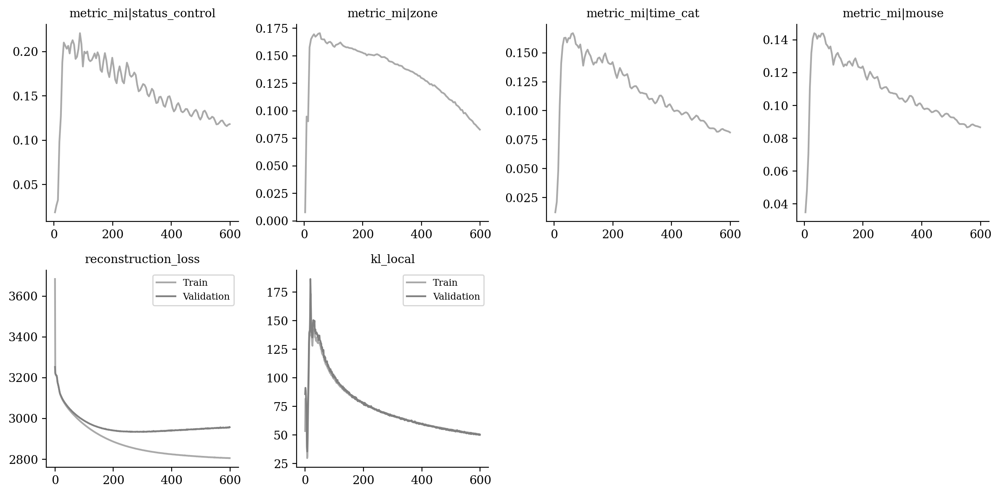

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

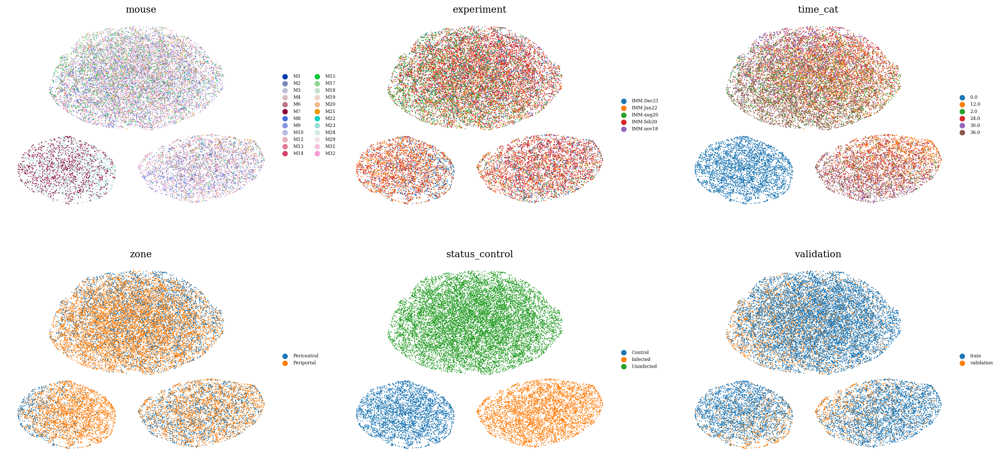

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

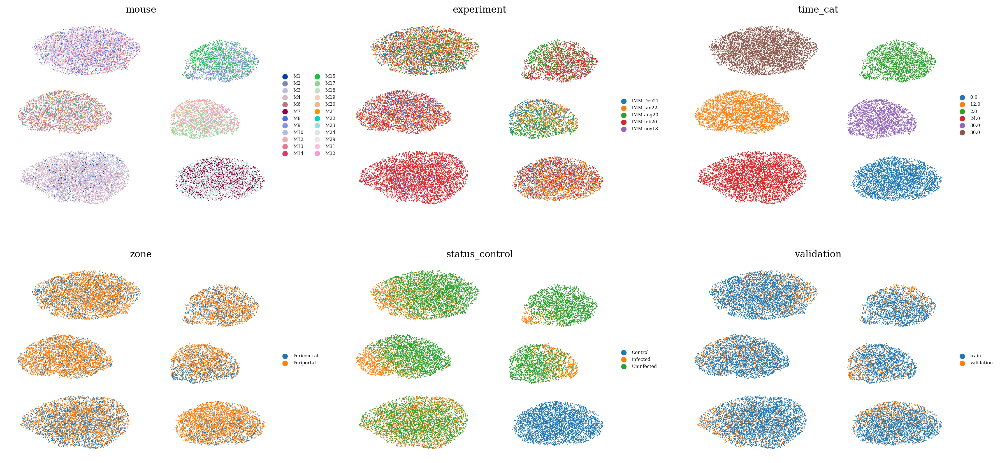

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

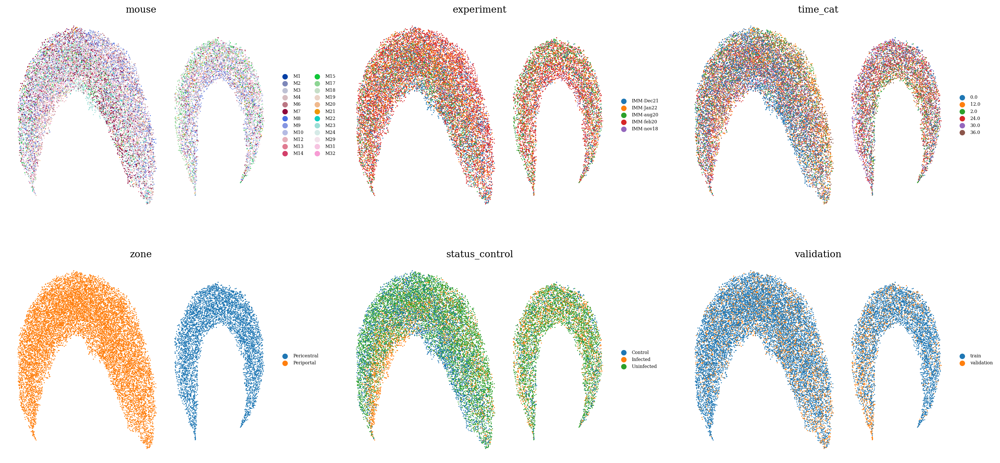

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

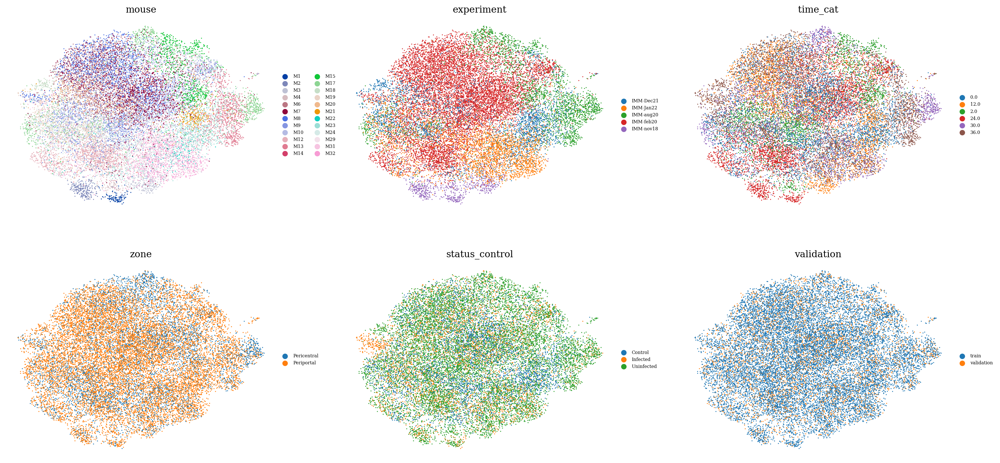

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

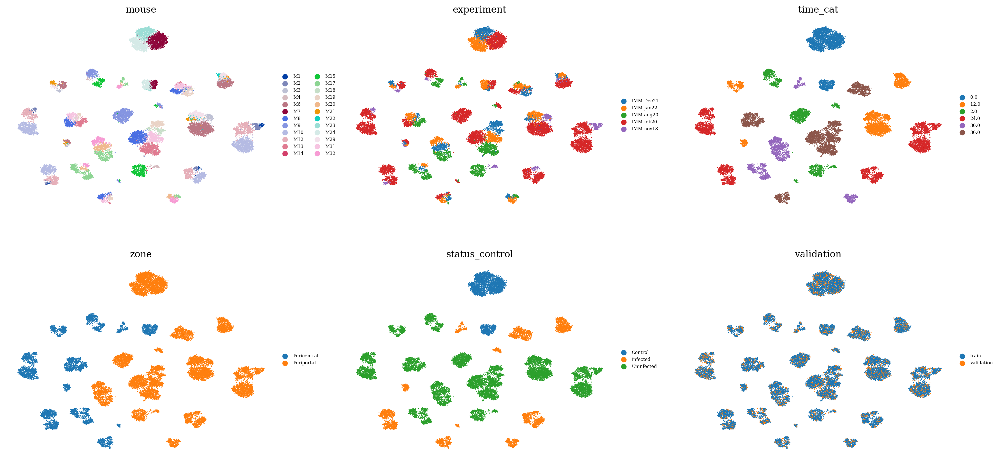

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

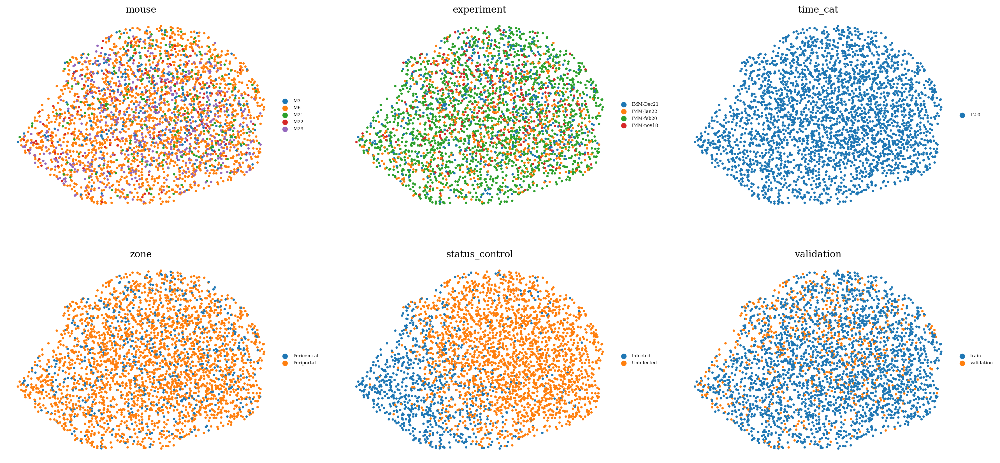

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )